

# Import packages and set settings

In [1]:
%load_ext autoreload
%autoreload 2

import sys
# sys.path.insert(1, './python_mods/')
sys.path.insert(1, '../../python_modules')
import plotting
import model_supp 
import model
import saving

In [2]:
%matplotlib inline
import pathlib
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
import numpy as np
import pandas as pd
import os
import collections
import h5py

In [3]:
# plt.style.use("seaborn-whitegrid")
plt.rcParams['figure.figsize'] = [10.0, 8.0]
plt.rcParams['axes.titlesize'] = 20
plt.rcParams['axes.labelsize'] = 18
plt.rcParams['xtick.labelsize'] = 14
plt.rcParams['ytick.labelsize'] = 14
plt.rcParams['grid.linestyle'] = '-'
plt.rcParams['legend.fontsize'] = 14
colors = [i['color'] for i in plt.rcParams['axes.prop_cycle']]

# Functions

# Model

## Model Functions

In [4]:
model_fxns = model.Model(model.M3, model.simulate_t100a_experiment_M3, model.M3_nopos, model.M3_on_off)

## Model Variables (Constants)

In [5]:
dt = 0.1
steps = 601
time = np.linspace(0,dt*steps,steps)
time2 = np.linspace(0,dt*3001,steps)

# MAP3K_t = model_supp.molarity_conversion(123+1207+1611) #ssk2+ssk22+ste11
# MAP2K_t = model_supp.molarity_conversion(4076)
# MAPK_t = model_supp.molarity_conversion(8225)
# PTP_t = model_supp.molarity_conversion(443+1324) # ptp2+ptp3


MAP3K_t = model_supp.molarity_conversion(701)
MAP2K_t = model_supp.molarity_conversion(2282)
MAPK_t = model_supp.molarity_conversion(5984)
PTP_t = model_supp.molarity_conversion(118+400)

MAP3K = 0.05*MAP3K_t # estimated (so not 0)
MAP2K = 0.05975380333*MAP2K_t # from the biological data
MAPK = 0.00540042381*MAPK_t  # from the biological data
gly = 0.00001 # placeholder (so not 0)
PTP = model_supp.molarity_conversion(118+400) # start with all on


labelnames = ['$- fb$', '$+ fb1$', '$+ fb2$', '$kb$',
              '$k_1$', '$k_3$', '$k_5$', '$s_1$', '$k_9$',
              '$k_2$', '$k_4$', '$k_6$', '$d_1$', '$k_{10}$',
              '$K_{M1}$', '$K_{M3}$', '$K_{M5}$', '$K_9$',
              '$K_{M2}$', '$K_{M4}$', '$K_{M6}$', '$K_{10}$']


minimums = [-4, -4, -4, 
        -4, -4, 
        -4, -4, 
        -4, -4, -4, -4,
        -4, -4, -4, -4, 
        -4, -4, -4, 
        -4, 
        -4, -4, -4]

maximums = [ 4, 4, 4, 
        4, 4, 4, 4, 4, 4, 4, 
        4, 4, 4, 4, 4, 4, 4, 
        4, 4, 4,
        4, 4]

diff = np.asarray(maximums)-np.asarray(minimums) #for plotting
dims = (diff, minimums) #for plotting

initials = [MAP3K, MAP2K, MAPK, gly, PTP]

params_constants = [MAP3K_t, MAP2K_t, MAPK_t, 1, PTP_t] 

doses = [0, 50000, 150000, 250000, 350000, 450000, 550000]
wt_doses = [150000, 550000]
t100a_doses = [150000, 550000]

# Load experimental data

In [6]:
exp_data, exp_time = model_supp.get_data()

mapk_wt_data, mapk_t100a_data, map2k_wt_data, map2k_t100a_data, hog1_ramp_data, hog1_ramp_inhib_data, pbs2_ramp_data, mapk_ptpD_data = exp_data
mapk_time, mapk_time_t100a_long, mapk_ramp_time = exp_time 

mapk_data_t100a_0 = [mapk_t100a_data[0]] 
mapk_time_t100a_0 = [0, 30, 60, 90, 120, 150, 180, 240, 300]

mapk_t100a_data = [mapk_t100a_data[1], mapk_t100a_data[2]] # exculde 0 because different timescale

# Fit to just 0 ptp 

## Load simulation data

In [7]:
folder = 'C:/Users/sksuzuki/Desktop/killdevil/runs_for_paper/190926_kb_M4_long/'

all_params, last_params, all_mses, last_mses = model_supp.get_sim_data(folder, num_sims=2000)


Number of runs collected: 1753
Best last gen MSE: 2665.709966122509
Mean last gen MSEs of top 5%: 3464.0890317338763


In [8]:
## sort
sorted_mses_EA, sorted_thetas_EA = model_supp.sort_mses_thetas(last_mses, last_params)

## Check EA results

No handles with labels found to put in legend.


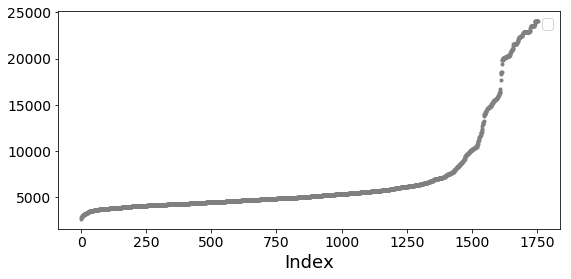

In [9]:
plotting.plt_idx_vs_mse(sorted_mses_EA, len(sorted_mses_EA))

No handles with labels found to put in legend.


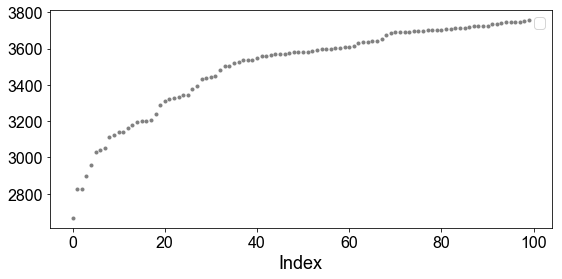

In [294]:
plotting.plt_idx_vs_mse(sorted_mses_EA, 100)

No handles with labels found to put in legend.


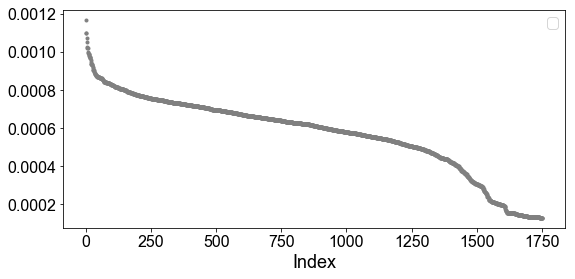

In [300]:
plotting.plt_pdf(1/sorted_mses_EA/np.sum(sorted_mses_EA)/np.sum(1/sorted_mses_EA/np.sum(sorted_mses_EA)), len(sorted_mses_EA))

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

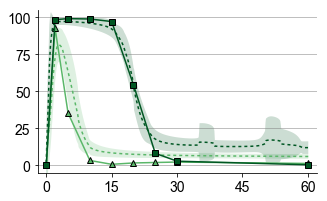

In [10]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA[:25], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

Dose: 0 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

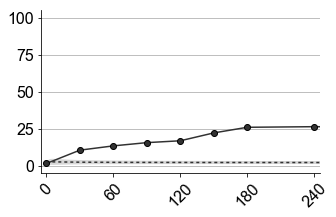

In [11]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA[:10], params_constants, initials,  [0], time2, 2,
                        exp_data=mapk_data_t100a_0, exp_time=mapk_time_t100a_0, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 150000 complete.
Dose: 550000 complete.


<Figure size 720x576 with 0 Axes>

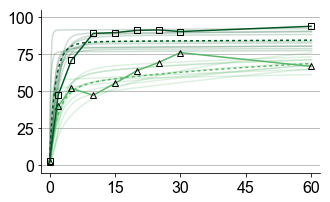

In [34]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA[:10], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_t100a_data, exp_time=mapk_time, ss=True, t100a=True, ptpD=False, ci='sd',
                        save_fig='')

Dose: 0 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

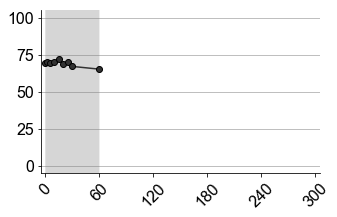

In [45]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA[:10], params_constants, initials, [0], time, 2,
                        exp_data=mapk_ptpD_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=True, ci='sd',
                        save_fig='')

In [37]:
mapk_ptpD_data_less = [mapk_ptpD_data[0], mapk_ptpD_data[2]]

Dose: 0 complete.
Dose: 350000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

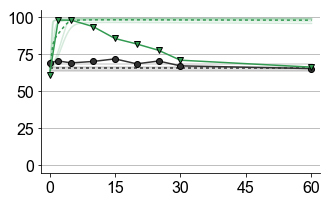

In [38]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA[:5], params_constants, initials,  [0, 350000], time, 2,
                        exp_data=mapk_ptpD_data_less, exp_time=mapk_time, ss=True, t100a=False, ptpD=True, ci='sd',
                        save_fig='')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:2

Dose: 0 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

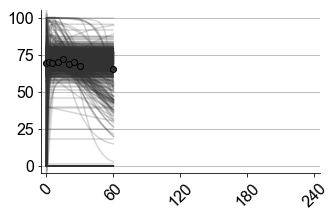

In [39]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA, params_constants, initials,  [0], time, 2,
                        exp_data=[mapk_ptpD_data[0], mapk_ptpD_data[2]], exp_time=mapk_time, ss=True, t100a=False, ptpD=True, ci='sd',
                         save_fig='')

ValueError: too many values to unpack (expected 18)

<Figure size 720x576 with 0 Axes>

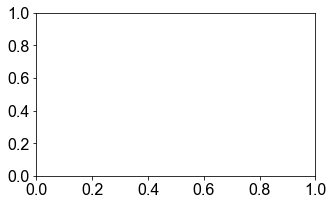

In [40]:
plotting.plt_param_cis_m2c_ptp(model_fxns, sorted_thetas_EA, params_constants, initials,  doses, time, 1,
                        exp_data=map2k_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

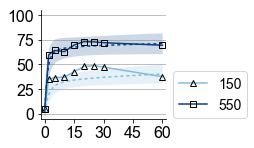

In [128]:
plotting.plt_param_cis_m2c_ptp(model_fxns, sorted_thetas_EA, params_constants, initials,  doses, time, 1,
                        exp_data=map2k_t100a_data, exp_time=mapk_time, ss=True, t100a=True, ptpD=False, ci='sd',
                        save_fig='')

In [513]:
sims = plotting.simdata_to_list(model_fxns, sorted_thetas_EA, params_constants, initials, time, 2, ss=True)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


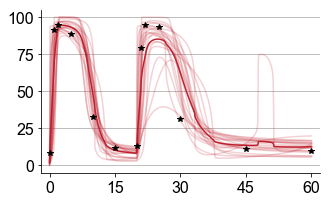

In [529]:
plotting.plt_ramp_cis(sims[:20], time, 600, ramp=1, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time, ci ='sd')

In [558]:
mses_p = []
for i in sorted_thetas_EA:
    mse_p = model_supp.calc_sim_score(model_fxns, i, exp_data, exp_time, params_constants, initials )[18]
    mses_p.append(mse_p)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:2

No handles with labels found to put in legend.


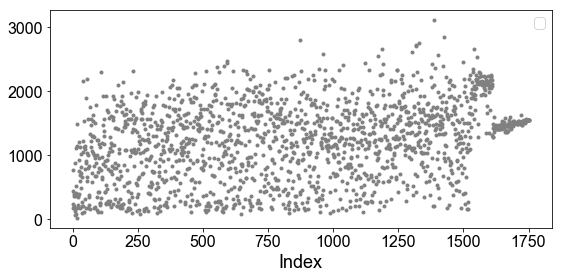

In [559]:
plotting.plt_idx_vs_mse(mses_p, len(mses_p))

In [560]:
mses_p_sort, thetas_p_sort = model_supp.sort_mses_thetas(mses_p, sorted_thetas_EA)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


0% complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


9% complete.
19% complete.
29% complete.
39% complete.
49% complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


59% complete.
69% complete.
79% complete.
89% complete.
99% complete.


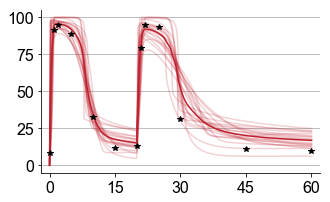

In [571]:
sims_p_sort = plotting.simdata_to_list(model_fxns, thetas_p_sort, params_constants, initials, time, 2, ss=True)
plotting.plt_ramp_cis(sims_p_sort[:20], time, 600, ramp=1, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time, ci ='sd')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

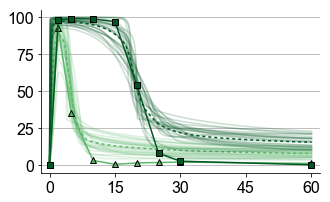

In [551]:
plotting.plt_param_cis(model_fxns, thetas_p_sort[:25], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

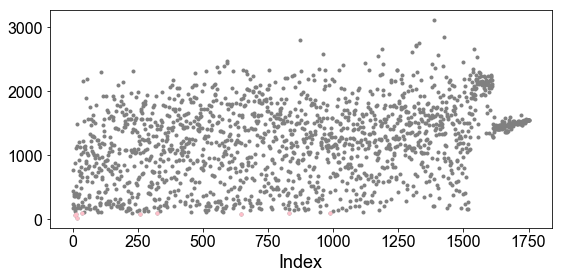

In [577]:
idx_p = plotting.plt_idx_vs_mse(mses_p, len(mses_p), data_thresh=100)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 150000 complete.
Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

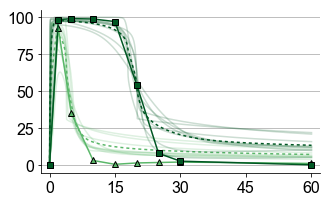

In [580]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA[idx_p], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

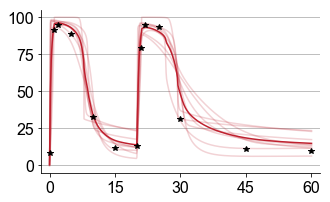

In [581]:
plotting.plt_ramp_cis(np.array(sims)[idx_p], time, 600, ramp=1, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time, ci ='sd')

In [680]:
mses_real = []
for i in sorted_thetas_EA:
    scores = model_supp.calc_sim_score(model_fxns, i, exp_data, exp_time, params_constants, initials, ptpD=True )
    mse_p = sum(scores[:18])+scores[19]
    mses_real.append(mse_p)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:2

Text(0.5,0,'MSE fit to training data')

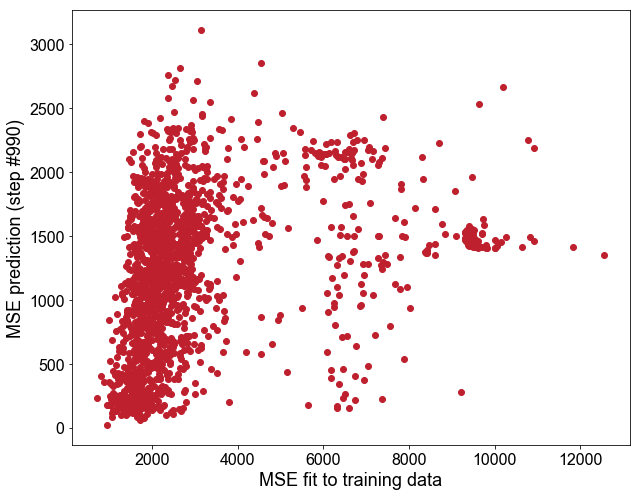

In [681]:
plt.plot(mses_real,mses_p, 'o')
plt.ylabel("MSE prediction (step #990)")
plt.xlabel("MSE fit to training data")

In [619]:
def create_thresh_col(df, x_t, y_t):
    df['Thresh'] = [1 if y < y_t and x < x_t else 2 if y > y_t and x < x_t else 3 if y < y_t and x > x_t else 4 for y, x in zip(df['MSE prediction'], df['MSE training'])]

In [682]:
mse_df = pd.DataFrame({'MSE prediction': mses_p, 'MSE training': mses_real})
create_thresh_col(mse_df, 1250, 500)
mse_df.head()

,MSE prediction,MSE training,Thresh
0,172.943896,1242.320255,1
1,775.583898,1236.372378,2
2,235.920635,711.966696,1
3,440.823569,1073.755347,1
4,214.948730,1097.335854,1


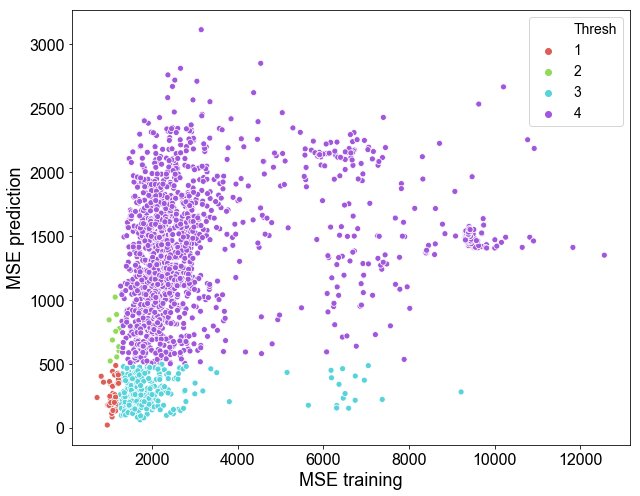

In [683]:
sns.scatterplot(x = 'MSE training', y = 'MSE prediction', data = mse_df, hue='Thresh', palette=sns.color_palette("hls", 4))

In [684]:
mse_df.groupby('Thresh').count()

,MSE prediction,MSE training
Thresh,,
1,38,38
2,10,10
3,238,238
4,1467,1467


In [685]:
good_mse = mse_df[mse_df['Thresh']==1]
good_mse.head()
good_idx = good_mse.index

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

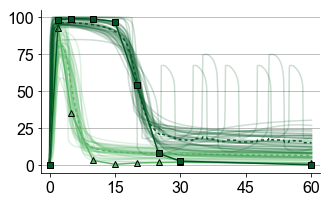

In [686]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA[good_idx], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

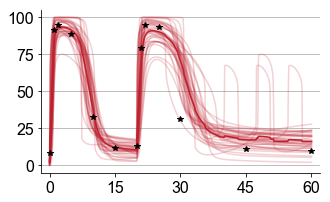

In [687]:
plotting.plt_ramp_cis(np.array(sims)[good_idx], time, 600, ramp=1, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time, ci ='sd')

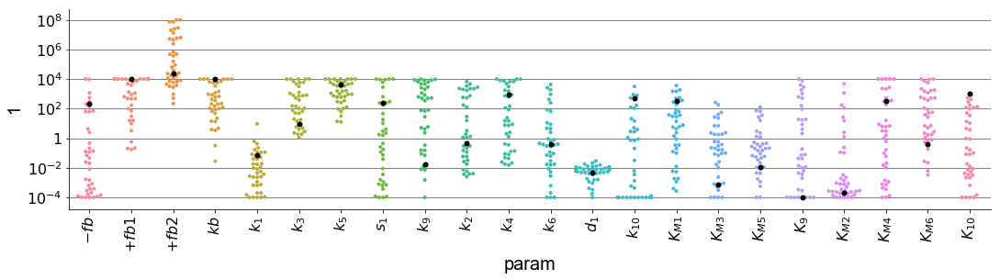

In [688]:
good =sorted_thetas_EA[good_idx]

# df_top_thetas_EA = pd.DataFrame(good)
# df_top_thetas_EA.columns = labelnames

# num_plt = 100
df_plt = pd.DataFrame(good)
df_plt.columns = labelnames
df_plt_log = df_plt.apply(np.log10)
df_plt_log_M = df_plt_log.melt(var_name='param', value_name='vals')
plotting.plt_param_ranges(labelnames, 'M2a', dims, df_plt_log_M, single_theta=df_plt_log, num=1) #black dot is best param

In [702]:
bad_mse = mse_df[mse_df['Thresh']==4]
bad_mse.head()
bad_idx = bad_mse.index

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

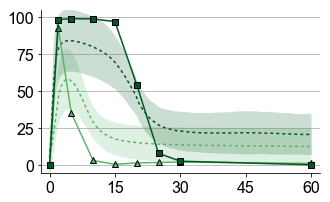

In [703]:
plotting.plt_param_cis(model_fxns, sorted_thetas_EA[bad_idx], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

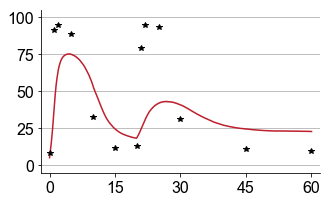

In [707]:
plotting.plt_ramp_cis(np.array(sims)[bad_idx], time, 600, ramp=1, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time, ci ='sd')

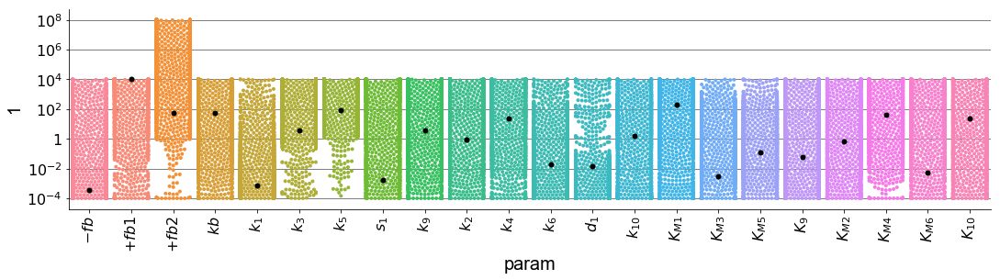

In [708]:
bad =sorted_thetas_EA[bad_idx]

# df_top_thetas_EA = pd.DataFrame(good)
# df_top_thetas_EA.columns = labelnames

# num_plt = 100
df_plt = pd.DataFrame(bad)
df_plt.columns = labelnames
df_plt_log = df_plt.apply(np.log10)
df_plt_log_M = df_plt_log.melt(var_name='param', value_name='vals')
plotting.plt_param_ranges(labelnames, 'M2a', dims, df_plt_log_M, single_theta=df_plt_log, num=1) #black dot is best param

In [535]:
# plotting.plt_idx_vs_mse(mses_p2, 100)

### PCA 

In [693]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

In [1013]:
df_test = pd.DataFrame(sorted_thetas_EA).drop_duplicates()

In [1015]:
x = StandardScaler().fit_transform(df_test)
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])
finalDf = pd.concat([principalDf, mse_df[['Thresh']]], axis = 1)

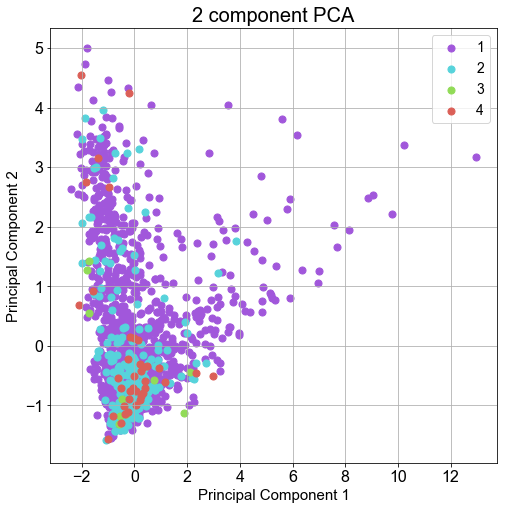

In [1016]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = range(1,5)
colors = sns.color_palette("hls", 4)
for target, color in zip(targets[::-1],colors[::-1]):
    indicesToKeep = finalDf['Thresh'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

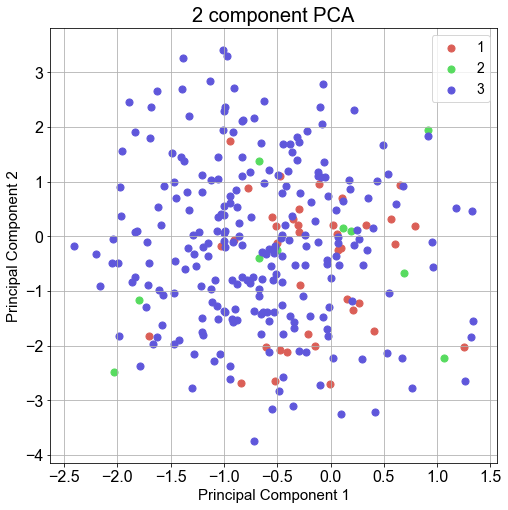

In [779]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = range(1,5)
colors = sns.color_palette("hls", 3)
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['Thresh'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

#### Good EA vs. First gen EAm

No handles with labels found to put in legend.


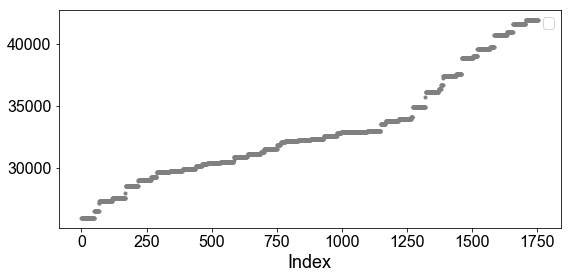

In [881]:
plotting.plt_idx_vs_mse(np.array(all_mses)[:,0], len(np.array(all_mses)[:,0]))

No handles with labels found to put in legend.


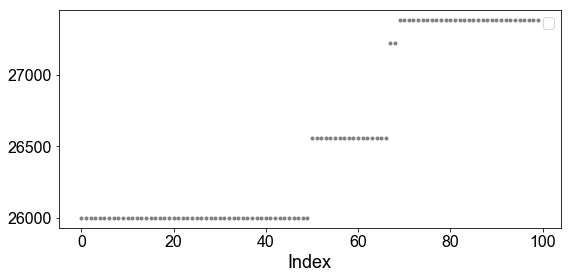

In [882]:
plotting.plt_idx_vs_mse(np.array(all_mses)[:,0], 100)

In [787]:
print(len(np.array(all_params)[:,0,:]))

1753


In [884]:
good_df_pca = pd.DataFrame(np.log10(good))
good_df_pca['Thresh'] = 1
worst_df_pca = pd.DataFrame(np.log10(np.array(all_params)[:,0,:]))
worst_df_pca['Thresh'] = 2

y = pd.concat([good_df_pca, worst_df_pca], axis = 0, ignore_index=True)

#### For saving

In [895]:
mses_bad = []
for params in np.array(all_params)[:,0,:]:
    mses = model_supp.calc_sim_score(model_fxns, params, exp_data, exp_time, params_constants, initials)
    mse_ = sum(mses[:18]) + mses[19]
    mses_bad.append(mse_)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


In [1041]:
good_df_pca = pd.DataFrame(np.log10(good))
good_df_pca['Thresh'] = 1
good_df_pca['MSE'] = [x for x in good_mse['MSE training']]
worst_df_pca = pd.DataFrame(np.log10(np.array(all_params)[:,0,:]))
worst_df_pca['Thresh'] = 2
worst_df_pca['MSE'] = mses_bad

y = pd.concat([good_df_pca, worst_df_pca], axis = 0, ignore_index=True).drop_duplicates().reset_index(drop=True)

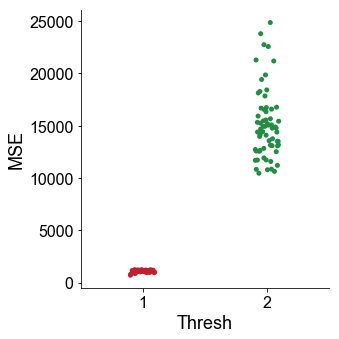

In [1038]:
sns.catplot(x ='Thresh', y ='MSE', data=y)

In [1042]:
y.columns = labelnames + ['Thresh', 'MSE']
# y['MSE'] = mses_bad
# y.to_csv('./Kimiko_params.csv')

In [1043]:
x = StandardScaler().fit_transform(y.iloc[:,:-2])
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(x)
principalDf = pd.DataFrame(data = principalComponents
             , columns = ['principal component 1', 'principal component 2'])
finalDf = pd.concat([principalDf, y[['Thresh']]], axis = 1)

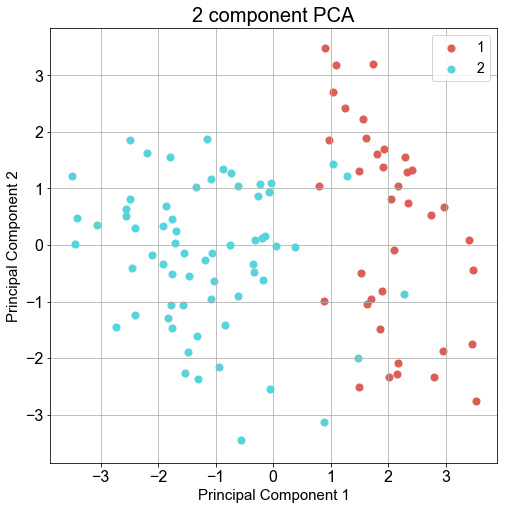

In [1044]:
fig = plt.figure(figsize = (8,8))
ax = fig.add_subplot(1,1,1) 
ax.set_xlabel('Principal Component 1', fontsize = 15)
ax.set_ylabel('Principal Component 2', fontsize = 15)
ax.set_title('2 component PCA', fontsize = 20)
targets = range(1,3)
colors = sns.color_palette("hls", 2)
for target, color in zip(targets,colors):
    indicesToKeep = finalDf['Thresh'] == target
    ax.scatter(finalDf.loc[indicesToKeep, 'principal component 1']
               , finalDf.loc[indicesToKeep, 'principal component 2']
               , c = color
               , s = 50)
ax.legend(targets)
ax.grid()

### Sensitivity analysis for "good" EA params

In [ ]:
sa_good = sa_values_ea[good_idx]

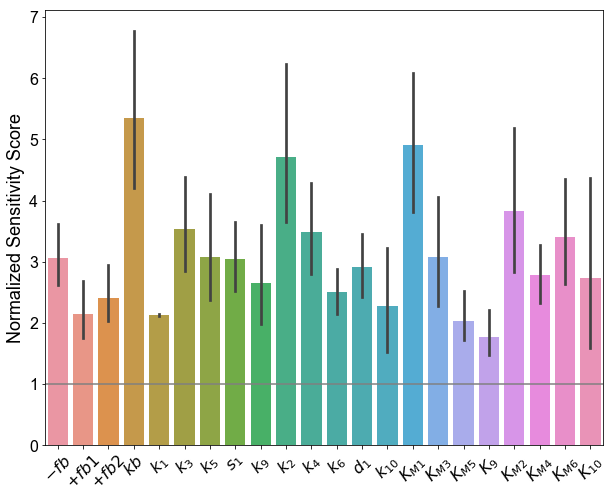

In [ ]:
ax = sns.barplot(data = np.log10(sa_good))
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


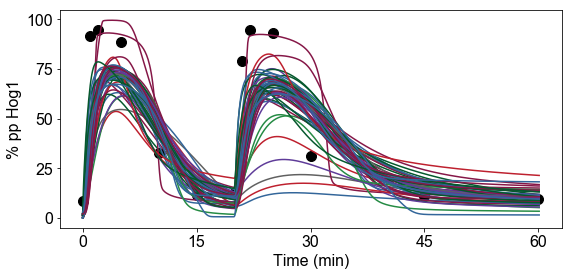

In [89]:
plotting.plt_ramp_behaviors(model_fxns, sorted_thetas_EA, 50, params_constants, initials, time, 2, ss = True, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


<Figure size 720x576 with 0 Axes>

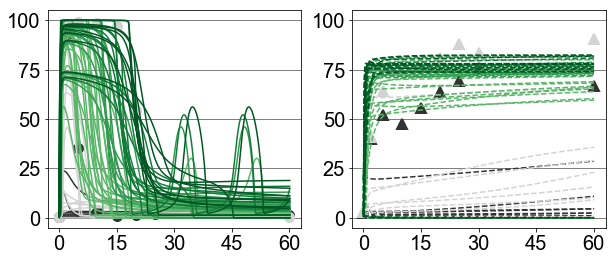

In [57]:
# original parameter values
plotting.plt_param_behaviors(model_fxns, sorted_thetas_EA, 10, params_constants, initials,  doses, time, 2, mapk_wt_data, mapk_t100a_data, mapk_time,ss=True)

ValueError: too many values to unpack (expected 18)

<Figure size 720x576 with 0 Axes>

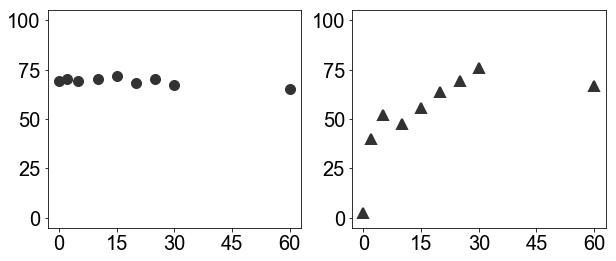

In [58]:
plotting.plt_param_behaviors(model_fxns, sorted_thetas_EA, 100, params_constants, initials,  [0], time, 2, mapk_ptpD_data, mapk_t100a_data, mapk_time,ss=True, ptpD=True)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


<Figure size 720x576 with 0 Axes>

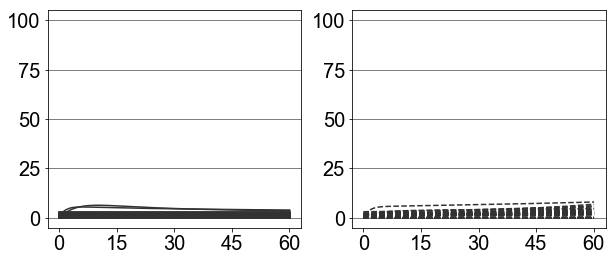

In [94]:
plotting.plt_param_behaviors_m2c_ptp(model_fxns, sorted_thetas_EA, 50, params_constants, initials,  [0], time, 2, None, None, mapk_time,ss=True, ptpD=False)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


<Figure size 720x576 with 0 Axes>

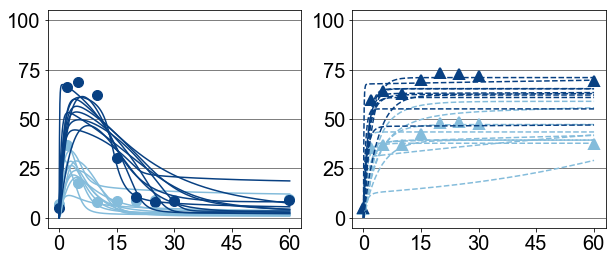

In [95]:
plotting.plt_param_behaviors(model_fxns, sorted_thetas_EA, 10, params_constants, initials,  [150000,550000], time, 1, map2k_wt_data, map2k_t100a_data, mapk_time,ss=True)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


<Figure size 720x576 with 0 Axes>

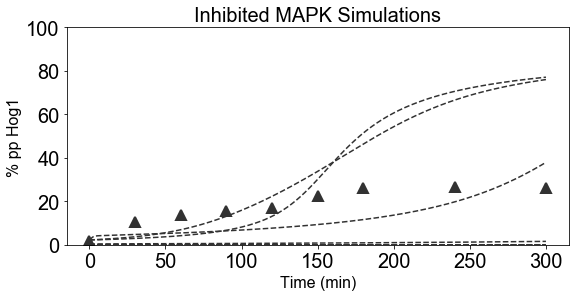

In [96]:
mapk_time_t100a_long = [0, 30, 60, 90, 120, 150, 180, 240, 300]

plotting.plt_t100a_long(model_fxns, sorted_thetas_EA, 10, params_constants, initials, mapk_data_t100a_long[0], mapk_time_t100a_long)

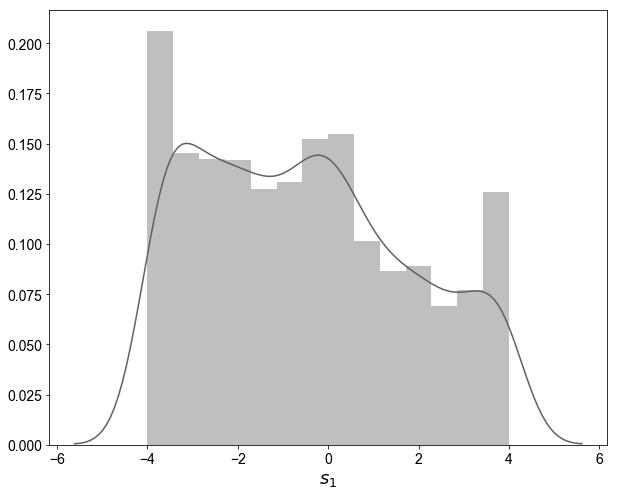

In [21]:
sns.distplot(np.log10(df_top_thetas_EA[labelnames[6]]))

In [42]:
sims_M2c_kb_ea_l = plotting.simdata_to_list(M2c_fxns, M2c_sorted_thetas_EA, params_constants, initials, time, 2, ss = True)

0% complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


9% complete.
19% complete.
29% complete.
39% complete.
49% complete.
59% complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


69% complete.
79% complete.
89% complete.
99% complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


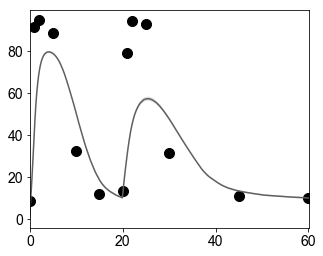

In [46]:
plotting.plt_ramp_cis(sims_M2c_kb_ea_l, time, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


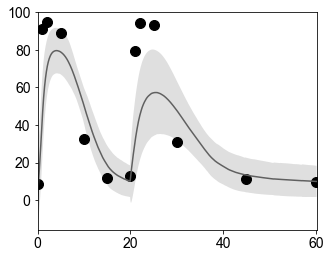

In [47]:
plotting.plt_ramp_cis(sims_M2c_kb_ea_l, time, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time, ci='sd')

# SMC

No handles with labels found to put in legend.


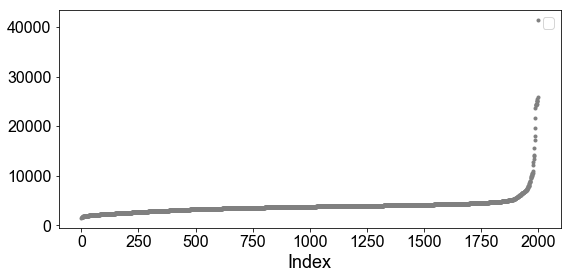

In [13]:
plotting.plt_idx_vs_mse(M2c_new_mses_EA, len(M2c_new_mses_EA))

In [14]:
M2c_EA_thetas_1perc = M2c_new_thetas_EA[:500]
M2c_EA_mses_1perc = M2c_new_mses_EA[:500]

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeserie

Dose: 0 complete.
Dose: 50000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 250000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 350000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 450000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

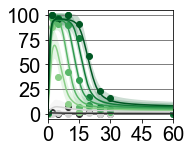

In [55]:
plotting.plt_param_cis(M2c_fxns, M2c_EA_thetas_1perc, params_constants, initials,  doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

## Define schedules

I've been messing around with where I start with the schedule and how many schedules to run

In [15]:
# e1, e2, e3, e4 = def_schedules(M2c_EA_mses_1perc)

# print("Best MSE: " + str(M2c_EA_mses_1perc[0]))
# print("Worst MSE: " + str(M2c_EA_mses_1perc[-1]))
# print()
# print("Schedules: " + str(e1),str(e2),str(e3),str(e4))
# print()


Best MSE: 1478.1430610228672
Worst MSE: 3211.9749030904018

Schedules: 3211.9749030904018 2345.0589820566347 1911.601021539751 1694.872041281309



## Fit distributions to parameter distributions

Found that parameter distributions are generally uniform. I think I'll use the parameter sets from the EA to seed the ABC SMC

### Test

In [83]:
data = np.log10(M2c_EA_thetas_1perc[:,5])

In [57]:
from scipy.stats import uniform


C:\Users\sksuzuki\Anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6571: UserWarning: The 'normed' kwarg is deprecated, and has been replaced by the 'density' kwarg.
  warnings.warn("The 'normed' kwarg is deprecated, and has been "


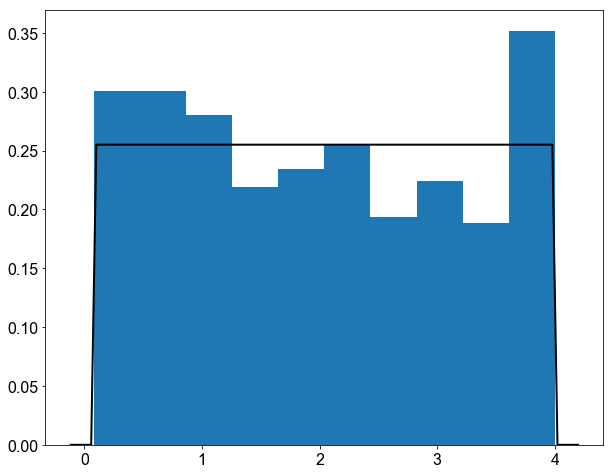

In [84]:
mu, std = uniform.fit(data)
plt.hist(data, normed=True)

xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = uniform.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)

In [64]:
from scipy.optimize import curve_fit

def gauss(x, *p):
    A, mu, sigma = p
    return A*np.exp(-(x-mu)**2/(2.*sigma**2))

In [66]:
hist, bin_edges = np.histogram(data, density=True)
bin_centres = (bin_edges[:-1] + bin_edges[1:])/2
p0 = [1., 2, 1.]

coeff, var_matrix = curve_fit(gauss, bin_centres, hist, p0=p0)


RuntimeError: Optimal parameters not found: Number of calls to function has reached maxfev = 800.

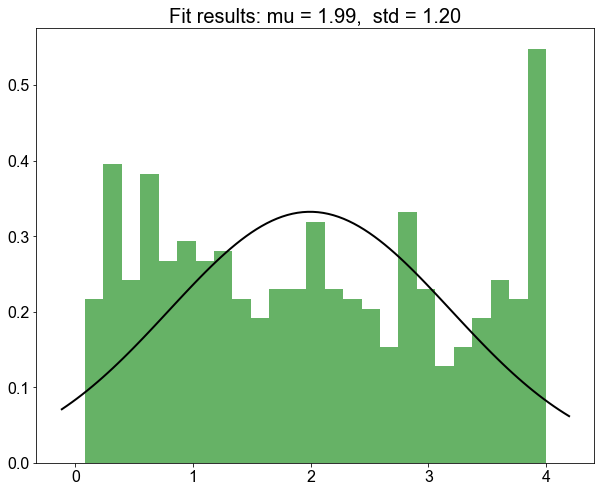

In [69]:
from scipy.stats import norm

mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(data, bins=25, density=True, alpha=0.6, color='g')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)
title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
plt.title(title)

plt.show()

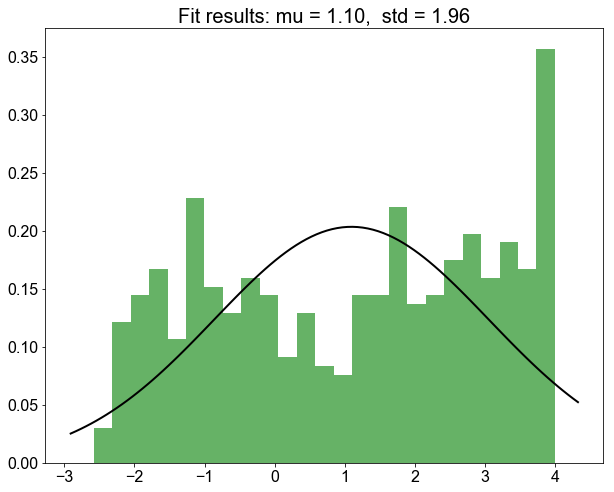

In [70]:
data = np.log10(M2c_EA_thetas_1perc[:,8])
mu, std = norm.fit(data)
plt.hist(data, bins=25, density=True, alpha=0.6, color='g')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2)
title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
plt.title(title)

plt.show()

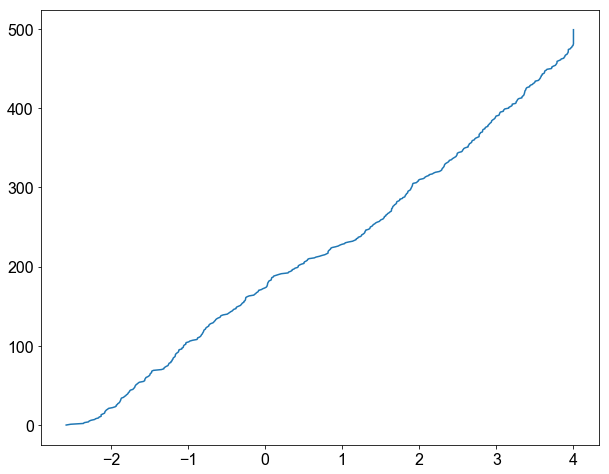

In [78]:
plt.plot( np.sort(data),[x for x in range(len(data))])

In [74]:
# import pymc3 as pm
import numpy as np
import matplotlib.pyplot as plt

# import theano.tensor as tt
# import shutil


In [75]:
n = 4

mu1 = np.ones(n) * (1. / 2)
mu2 = -mu1

stdev = 0.1
sigma = np.power(stdev, 2) * np.eye(n)
isigma = np.linalg.inv(sigma)
dsigma = np.linalg.det(sigma)

w1 = 0.1
w2 = (1 - w1)

# ABC SMC

## Check recalculation of EA MSEs

In [12]:
base = 'C:/Users/sksuzuki/Desktop/killdevil/runs_for_paper/abc_smc/200213_kb_M4_ea_abc_smc/'

ea = h5py.File(base+'200213_kb_M4_ea_abc_smc_0000.hdf5', 'r')

In [22]:
ea_thetas = ea['thetas']
ea_mses = ea['mses']

No handles with labels found to put in legend.


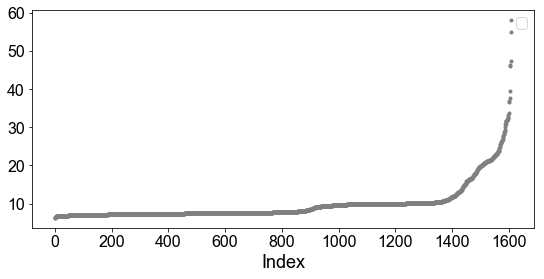

In [74]:
plotting.plt_idx_vs_mse(np.log(ea_mses), len(ea_mses))

No handles with labels found to put in legend.


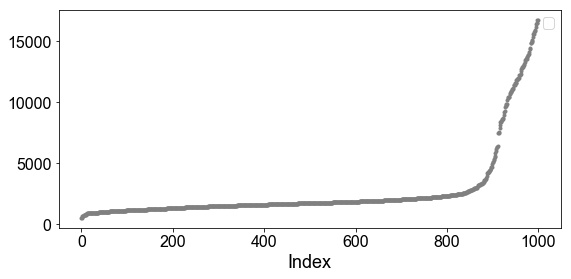

In [75]:
plotting.plt_idx_vs_mse(ea_mses, 1000)

In [11]:
plotting.plt_param_cis(model_fxns, ea_thetas, params_constants, initials, wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

NameError: name 'ea_thetas' is not defined

In [246]:
df_top_thetas_EA_ea = pd.DataFrame(np.array(ea_thetas))
df_top_thetas_EA_ea.columns = labelnames

num_plt = 100
df_plt = pd.DataFrame(ea_thetas[:num_plt])
df_plt.columns = labelnames
df_plt_log = df_plt.apply(np.log10)
df_plt_log_M = df_plt_log.melt(var_name='param', value_name='vals')
plotting.plt_param_ranges(labelnames, 'M2a', dims, df_plt_log_M, single_theta=df_plt_log, num=0) #black dot is best param

NameError: name 'ea_thetas' is not defined

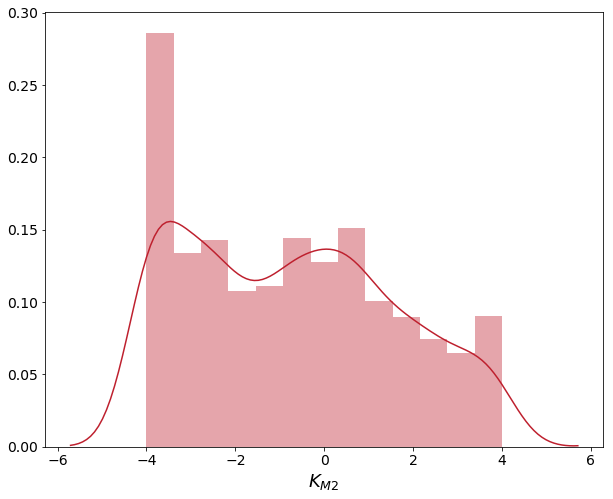

In [53]:
sns.distplot(np.log10(df_top_thetas_EA_ea[labelnames[18]]))

In [26]:
e2 = h5py.File(base+'200310_M3_abc_0002.hdf5', 'r')
e2_thetas = e2['thetas']
e2_mses = e2['mses']

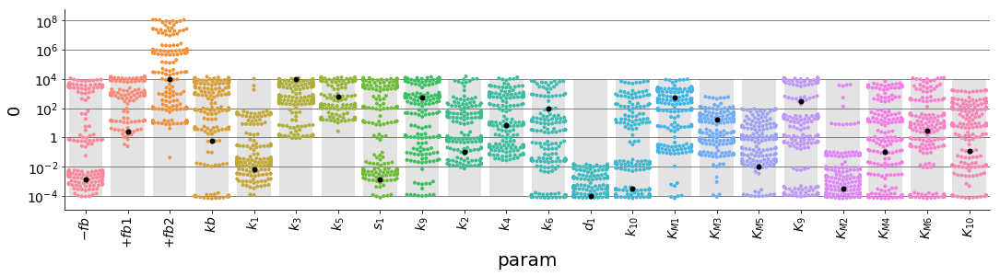

In [35]:
Km5 = pd.DataFrame({0: df_top_thetas_EA_ea[labelnames[18]],
2: df_top_thetas_EA_e2[labelnames[18]],
3: df_top_thetas_EA_e3[labelnames[18]],
5: df_top_thetas_EA[labelnames[18]]})

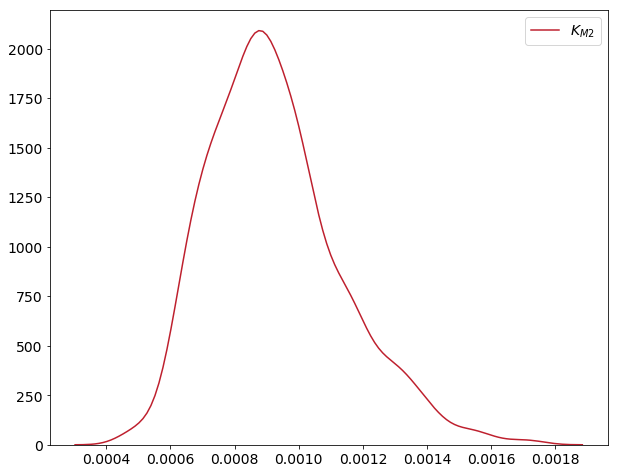

In [54]:
# sns.kdeplot(df_top_thetas_EA_ea[labelnames[18]])
# sns.kdeplot(df_top_thetas_EA_e2[labelnames[18]])
# sns.distplot(df_top_thetas_EA_e3[labelnames[18]])
sns.kdeplot(df_top_thetas_EA[labelnames[18]])

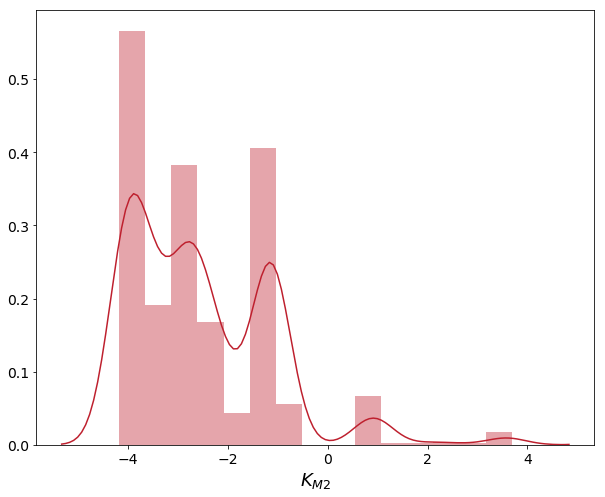

In [30]:
sns.distplot(np.log10(df_top_thetas_EA_e2[labelnames[18]]))

## 3rd schedule

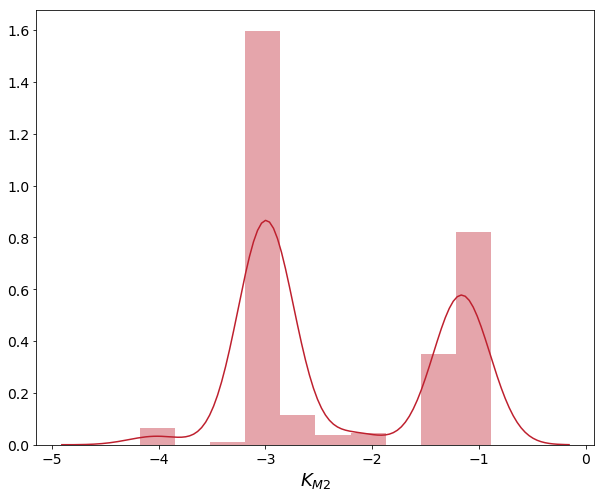

In [31]:
sns.distplot(np.log10(df_top_thetas_EA_e3[labelnames[18]]))

## Last schedule result

In [19]:
base_folder = 'C:/Users/sksuzuki/Documents/Research/figures/paper1/S5/'

In [13]:
e4 = h5py.File(base+'200213_kb_M4_ea_abc_smc_0004.hdf5', 'r')
e4_thetas = e4['thetas']
e4_mses = e4['mses']

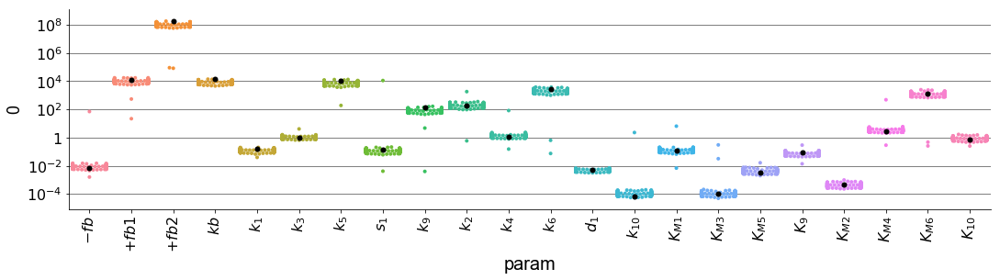

In [14]:
df_top_thetas_EA = pd.DataFrame(np.array(e4_thetas))
df_top_thetas_EA.columns = labelnames

num_plt = 200
df_plt = pd.DataFrame(e4_thetas[:num_plt])
df_plt.columns = labelnames
df_plt_log = df_plt.apply(np.log10)
df_plt_log_M = df_plt_log.melt(var_name='param', value_name='vals')
plotting.plt_param_ranges(labelnames, 'M2a', dims, df_plt_log_M, single_theta=df_plt_log, num=0) #black dot is best param

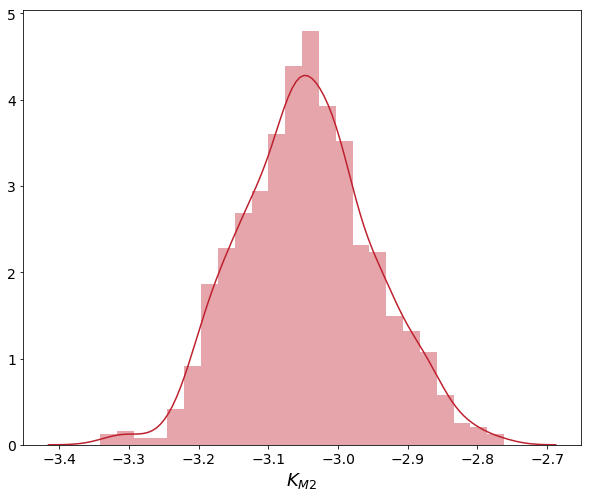

In [32]:
sns.distplot(np.log10(df_top_thetas_EA[labelnames[18]]))

No handles with labels found to put in legend.


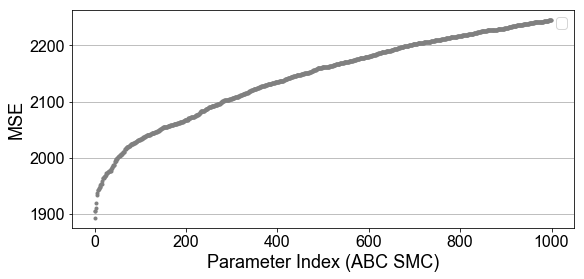

In [800]:
plotting.plt_idx_vs_mse(e4_mses, len(e4_mses), sorting=True)
plt.ylabel('MSE')
plt.xlabel('Parameter Index (ABC SMC)')
plt.grid(color='grey', linestyle='-', axis='y', linewidth=.5)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

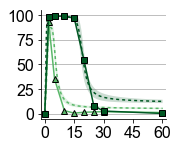

In [20]:
plotting.plt_param_cis(model_fxns, e4_thetas, params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig=base_folder+'A_00')

[0, 150000, 550000]
[0.00052538 0.00125061 0.00537958 0.14616205 0.01836695]
hi
[0.0004662  0.00121286 0.00525269 0.08047742 0.01849546]
hi
[0.00042237 0.00096093 0.00360984 0.09009075 0.01876018]
hi
[0.00033548 0.00084526 0.00356128 0.05715142 0.01894858]
hi
[0.00026303 0.00073547 0.00311215 0.09348499 0.01879988]
hi
[0.00046193 0.00129761 0.00602472 0.12096659 0.01868349]
hi
[0.00045852 0.00117003 0.00439537 0.1163892  0.01853753]
hi
[0.00045805 0.00100019 0.00405217 0.11352509 0.01881758]
hi
[0.00042552 0.00091712 0.00427489 0.12619644 0.01892465]
hi
[0.00048201 0.00128896 0.00542284 0.13879787 0.01807747]
hi
[0.0004808  0.00108176 0.00455601 0.1231392  0.01904375]
hi
[0.00043275 0.00100858 0.00535057 0.13463704 0.01853662]
hi
[0.00057035 0.00136098 0.00684258 0.09544109 0.01804645]
hi
[0.0004802  0.001199   0.00562668 0.12547376 0.01871752]
hi
[0.00041403 0.00108015 0.0043304  0.10764208 0.01867728]
hi
[0.00038063 0.00102431 0.00414578 0.08434055 0.01847622]
hi
[0.00034559 0.001003

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


[0.00050341 0.0011669  0.00486153 0.09091818 0.01890196]
hi
[0.00058042 0.00138275 0.00684713 0.11541786 0.01798796]
hi
[0.00047214 0.00128368 0.00504994 0.10350636 0.0185777 ]
hi
[0.00036794 0.00104549 0.00389228 0.07101553 0.01876407]
hi
[0.00045054 0.00107282 0.0047594  0.07357162 0.01880204]
hi
[0.00040262 0.00104563 0.00480665 0.14151172 0.0189091 ]
hi
[0.00043246 0.00102783 0.00474244 0.14509827 0.01842536]
hi
[0.00042634 0.00121527 0.00521588 0.14335196 0.01828622]
hi
[0.00045409 0.00115927 0.00490213 0.08701068 0.01882117]
hi
[0.00031539 0.00082956 0.00392942 0.0969165  0.01860451]
hi
[0.00037185 0.00088318 0.0042116  0.10066822 0.01888446]
hi
[0.00044073 0.00119452 0.00517098 0.1752132  0.0187444 ]
hi
[0.00043768 0.00114136 0.00532942 0.13830389 0.01840573]
hi
[0.00046988 0.00118954 0.00465572 0.13094345 0.01909729]
hi
[0.00046903 0.0011883  0.0049202  0.12477515 0.01864417]
hi
[0.00037604 0.00100722 0.00466405 0.14442806 0.01844875]
hi
[0.00050388 0.00112993 0.00497275 0.1046

[0.00038063 0.00102431 0.00414578 0.08434055 0.01847622]
hi
[0.00034559 0.00100331 0.00380099 0.08903098 0.01871307]
hi
[0.00040751 0.00108292 0.00468062 0.12161627 0.01864546]
hi
[0.00037721 0.00104075 0.00417302 0.0766932  0.01867389]
hi
[0.00039664 0.00099362 0.00367265 0.08530124 0.01867183]
hi
[0.00044073 0.00106253 0.00435739 0.07395245 0.01872703]
hi
[0.00047699 0.00118893 0.00500153 0.14285438 0.01900535]
hi
[0.00047849 0.00140091 0.00528217 0.08553294 0.01881457]
hi
[0.00036046 0.00089354 0.0037033  0.11780571 0.01822164]
hi
[0.0004435  0.00146197 0.00531707 0.09556246 0.01860994]
hi
[0.0004521  0.00139351 0.00469763 0.14460542 0.01875717]
hi
[0.000476   0.00121221 0.00485905 0.15210487 0.01877694]
hi
[0.00052638 0.00158981 0.00645939 0.10612336 0.01870856]
hi
[0.00051359 0.00141986 0.00502704 0.08451486 0.01873017]
hi
[0.00034249 0.00093437 0.00332903 0.12365874 0.01911676]
hi
[0.00034402 0.00092934 0.00362319 0.11802856 0.01864526]
hi
[0.00045375 0.00126927 0.00530101 0.1137

KeyboardInterrupt: 

<Figure size 720x576 with 0 Axes>

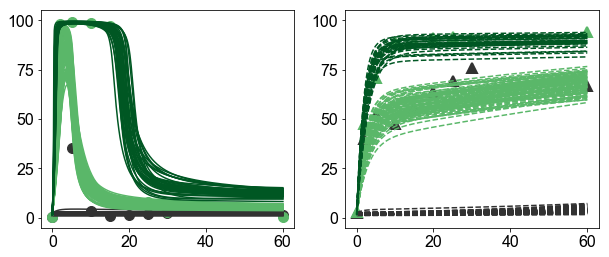

In [15]:
# original parameter values
plotting.plt_param_behaviors(model_fxns, e4_thetas, 100, params_constants, initials,  [0, 150000, 550000], time, 2, mapk_wt_data, mapk_t100a_data, mapk_time,ss=True)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


<Figure size 720x576 with 0 Axes>

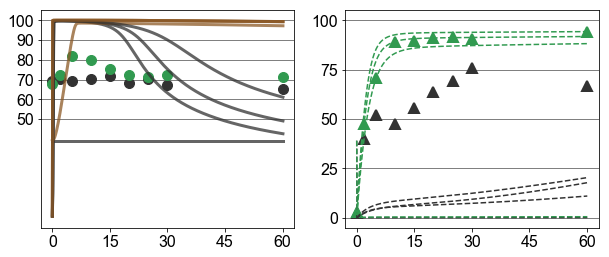

In [15]:
# original parameter values
plotting.plt_param_behaviors(model_fxns, e4_thetas, 100, params_constants, initials,  [0, 350000], time, 2, mapk_ptpD_data, mapk_t100a_data, mapk_time,ss=True, ptpD=True)

Dose: 0 complete.
Dose: 350000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

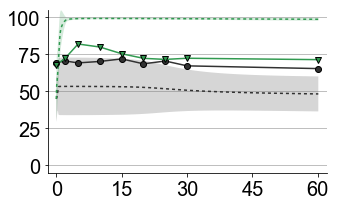

In [16]:
plotting.plt_param_cis(model_fxns, e4_thetas[:10], params_constants, initials,  [0, 350000], time, 2,
                        exp_data=mapk_ptpD_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=True, ci='sd',
                        save_fig='')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)


<Figure size 432x288 with 0 Axes>

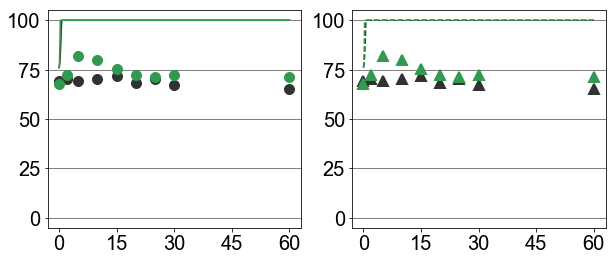

In [120]:
# original parameter values
ptpD_total_protein = params_constants[:-1] + [0]
ptpD_inits = initials[:-1] + [0]

plotting.plt_param_behaviors(model_fxns, e4_thetas, 1, ptpD_total_protein, ptpD_inits,  [0, 350000], time, 2, mapk_ptpD_data, mapk_ptpD_data, mapk_time,ss=True)

Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 432x288 with 0 Axes>

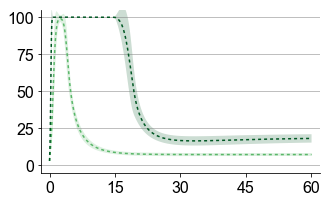

In [93]:
plotting.plt_param_cis(model_fxns_nopos, e4_thetas, params_constants, initials,  model_fxns, time, 2,
                        exp_data=None, exp_time=None, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 150000 complete.
Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

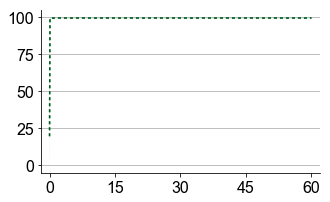

In [199]:
plotting.plt_param_cis(model_fxns_noneg, e4_thetas[:10], params_constants, initials,  doses, time, 2,
                        exp_data=None, exp_time=None, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

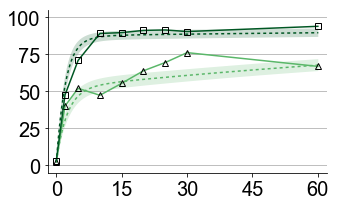

In [16]:
plotting.plt_param_cis(model_fxns, e4_thetas, params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_t100a_data, exp_time=mapk_time, ss=True, t100a=True, ptpD=False, ci='sd',
                        save_fig='')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)


Dose: 0 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

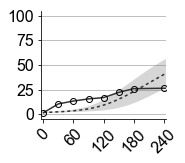

In [22]:
plotting.plt_param_cis(model_fxns, e4_thetas, params_constants, initials,  [0], time2, 2,
                        exp_data=mapk_data_t100a_0, exp_time=mapk_time_t100a_0, ss=True, t100a=True, ptpD=False, ci='sd',
                        save_fig=base_folder+'C_00')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

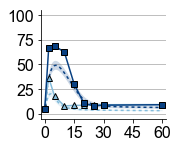

In [23]:
plotting.plt_param_cis(model_fxns, e4_thetas, params_constants, initials,  wt_doses, time, 1,
                        exp_data=map2k_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig=base_folder+'D_00')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

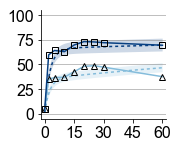

In [24]:
plotting.plt_param_cis(model_fxns, e4_thetas, params_constants, initials,  wt_doses, time, 1,
                        exp_data=map2k_t100a_data, exp_time=mapk_time, ss=True, t100a=True, ptpD=False, ci='sd',
                        save_fig=base_folder+'E_00')

In [34]:
base = 'C:/Users/sksuzuki/Desktop/killdevil/runs_for_paper/abc_smc/200310_M3_abc/'
e4 = h5py.File(base+'200310_M3_abc_0004.hdf5', 'r')
e4_thetas = e4['thetas']
e4_mses = e4['mses']

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

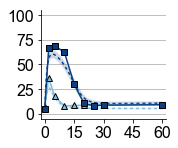

In [36]:
MAP3K_t = model_supp.molarity_conversion(123+1207+1611) #ssk2+ssk22+ste11
MAP2K_t = model_supp.molarity_conversion(4076)
MAPK_t = model_supp.molarity_conversion(8225)
PTP_t = model_supp.molarity_conversion(443+1324) # ptp2+ptp3
PTP = model_supp.molarity_conversion(443+1324) # start with all on

# MAP3K_t = model_supp.molarity_conversion(701)
# MAP2K_t = model_supp.molarity_conversion(2282)
# MAPK_t = model_supp.molarity_conversion(5984)
# PTP_t = model_supp.molarity_conversion(118+400) # including ptc1

initials = [MAP3K, MAP2K, MAPK, gly, PTP]

params_constants = [MAP3K_t, MAP2K_t, MAPK_t, 1, PTP_t] 

plotting.plt_param_cis(model_fxns, e4_thetas, params_constants, initials,  wt_doses, time, 1,
                        exp_data=map2k_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig=base_folder+'D_01')

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 0 complete.


<Figure size 720x576 with 0 Axes>

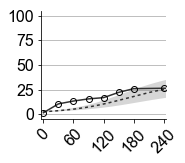

In [37]:
plotting.plt_param_cis(model_fxns, e4_thetas, params_constants, initials,  [0], time2, 2,
                        exp_data=mapk_data_t100a_0, exp_time=mapk_time_t100a_0, ss=True, t100a=True, ptpD=False, ci='sd',
                        save_fig=base_folder+'C_01')

In [97]:
e1 = h5py.File('C:/Users/sksuzuki/Documents/GitHub/HOG_encoding_feedbacks/python_modules/ABC_SMC/200121_M3c_ea_abc_smc/200121_M3c_ea_abc_smc_0001.hdf5', 'r')

In [98]:
e1_thetas = e1['thetas']
e1_mses = e1['mses']

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


Dose: 0 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 50000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 250000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 350000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 450000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

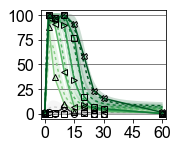

In [99]:
plotting.plt_param_cis(M2c_fxns, e1_thetas, params_constants, initials,  doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='test02')

In [100]:
e4 = h5py.File('C:/Users/sksuzuki/Documents/GitHub/HOG_encoding_feedbacks/python_modules/ABC_SMC/200121_M3c_ea_abc_smc/200121_M3c_ea_abc_smc_0004.hdf5', 'r')

e4_thetas = e4['thetas']
e4_mses = e4['mses']

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1000.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)


Dose: 0 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 50000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 150000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 250000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 350000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 450000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

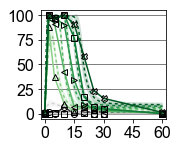

In [102]:
plotting.plt_param_cis(M2c_fxns, e4_thetas, params_constants, initials,  doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                        save_fig='test03')

In [1]:
inhib_sims = plotting.inhibdata_to_list(model_fxns, thetas_e4_sort[:10], params_constants, initials, time, 3, sig=450000, run_type=['ramp'], ss = True)

NameError: name 'plotting' is not defined

C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


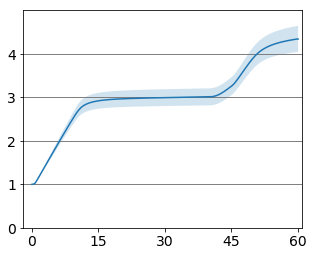

In [129]:
plotting.plt_inhib_cis(M4_inhib_sims, time, 3, ci="sd") #t>5 with ramp

C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


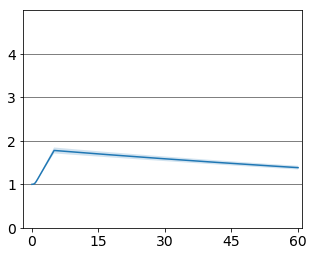

In [134]:
plotting.plt_inhib_cis(M4_inhib_sims, time, 3, ci="sd") #t>5 with ramp

## Sensitivity Analysis

In [21]:
base = 'C:/Users/sksuzuki/Desktop/killdevil/runs_for_paper/abc_smc/200213_kb_M4_ea_abc_smc/'

e4 = h5py.File(base+'200213_kb_M4_ea_abc_smc_0004.hdf5', 'r')

e4_thetas = e4['thetas']
e4_mses = e4['mses']

mses_e4_sort, thetas_e4_sort = model_supp.sort_mses_thetas(e4_mses, e4_thetas)

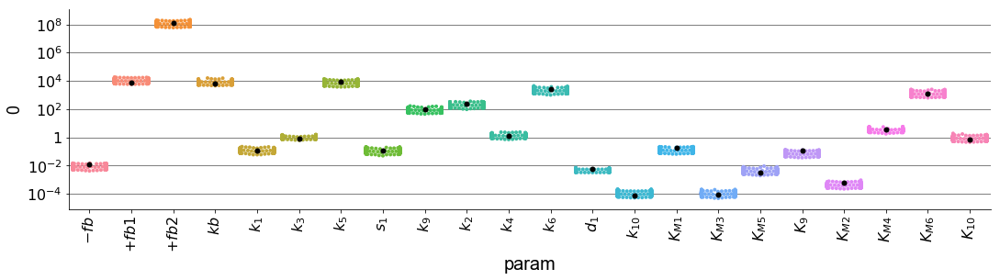

In [248]:
df_top_thetas_EA_e4 = pd.DataFrame(np.array(thetas_e4_sort))
df_top_thetas_EA_e4.columns = labelnames

num_plt = 500
df_plt = pd.DataFrame(thetas_e4_sort[:num_plt])
df_plt.columns = labelnames
df_plt_log = df_plt.apply(np.log10)
df_plt_log_M = df_plt_log.melt(var_name='param', value_name='vals')
plotting.plt_param_ranges(labelnames, 'M2a', dims, df_plt_log_M, single_theta=df_plt_log, num=0) #black dot is best param

In [22]:
best_param_set = thetas_e4_sort[0]
print(best_param_set)

[1.26773577e-02 7.11484383e+03 1.17924038e+08 6.54517277e+03
 1.18868362e-01 8.36293353e-01 8.12846153e+03 1.18738115e-01
 9.51999857e+01 2.35231373e+02 1.29062005e+00 2.56980496e+03
 6.05326020e-03 7.96742622e-05 1.74141267e-01 8.96447657e-05
 3.03350386e-03 1.10604006e-01 6.39237905e-04 3.84656508e+00
 1.21074078e+03 6.89164169e-01]


Dose: 150000 complete.
Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

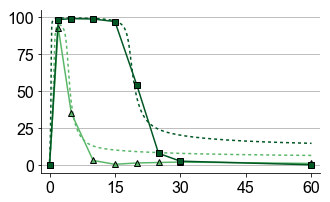

In [499]:
last_param_set = thetas_e4_sort[-1]
plotting.plt_param_cis(model_fxns, [last_param_set], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                         save_fig='', save_as='')

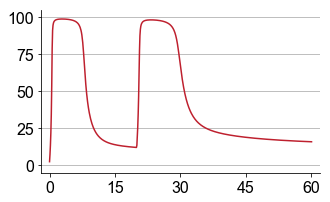

In [510]:
sims = plotting.simdata_to_list(model_fxns, [last_param_set], params_constants, initials, time, 2, ss=True)
plotting.plt_ramp_cis(sims, time, 60, ramp=0, hog1_ramp_data=None, mapk_ramp_time=None, ci='std', save_fig='')


### Check fits

Dose: 150000 complete.
Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

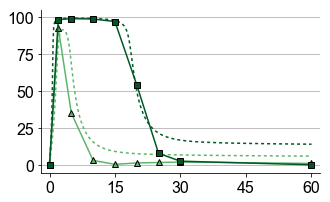

In [24]:
plotting.plt_param_cis(model_fxns, [best_param_set], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                         save_fig='', save_as='')

Text(0.5,0,'Time (min)')

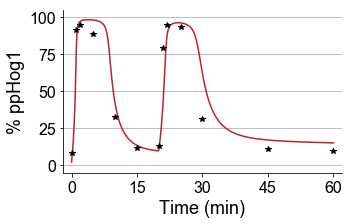

In [810]:
sims_bs = plotting.simdata_to_list(model_fxns, [best_param_set], params_constants, initials, time, 2, ss=True)
plotting.plt_ramp_cis(sims_bs, time, 60, ramp=0, hog1_ramp_data=hog1_ramp_data, mapk_ramp_time=mapk_ramp_time, ci='std', save_fig='')
plt.ylabel('% ppHog1')
plt.xlabel('Time (min)')

Dose: 150000 complete.
Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

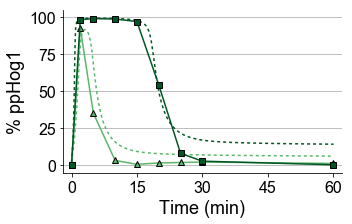

In [804]:
plotting.plt_param_cis(model_fxns, [best_param_set], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_t100a_data, exp_time=mapk_time, ss=True, t100a=True, ptpD=False, ci='sd',
                         save_fig='', save_as='')

In [ ]:
sims_bs = plotting.simdata_to_list(model_fxns, [best_param_set], params_constants, initials, time, 2, ss=True)
plotting.plt_ramp_cis(sims_bs, time, 60, ramp=0, hog1_ramp_data=None, mapk_ramp_time=None, ci='std', save_fig='')

In [50]:
best_score = model_supp.calc_sim_score(model_fxns, best_param_set, exp_data, exp_time, params_constants, initials )

[175.56910292  67.20508042   0.           0.           0.
   0.           0.         158.53466742  68.96123301   7.45845581
   0.           0.           0.           0.          69.9332911
 290.24678715  94.59880962 138.75046044 233.52547619 267.34296477
 536.17851651 334.75635243 184.66633902]
Hog1 fit to WT: 242.77418334597482
Hog1 fit to T100A: 234.95435624014405
Pbs2 fit to WT: 360.18007825701756
Pbs2 fit to T100A: 233.34927005985588
Hog1 fit to Ramp: 233.52547618771538
Hog1 fit to PtpD: 1322.9441727332144


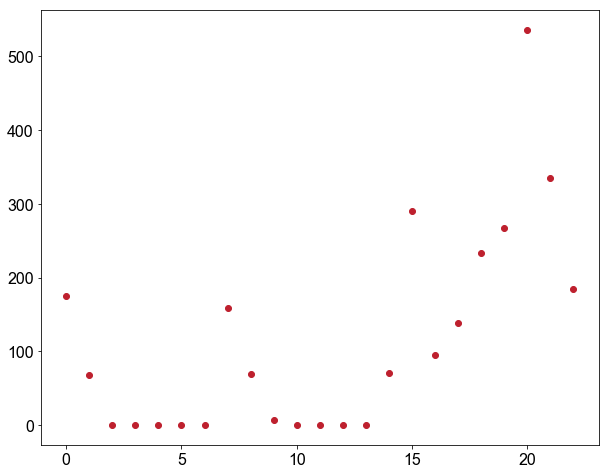

In [47]:
plt.plot(best_score, 'o')

### Local sensitivity analysis

$ S_{ij} = \frac{\delta O_i}{\delta p_j} \approx \frac{O_i(p_j+\Delta p_j) - O_i(p_j-\Delta p_j)}{2 \Delta p_j}$ 

$ S_{ij}^{norm} = \frac{\frac{\delta O_i}{O_i}}{\frac{\delta p_j}{p_j}} \approx \frac{\frac{O_i(p_j+\Delta p_j) - O_i(p_j-\Delta p_j)}{O_i}}{\frac{2 \Delta p_j}{p_j}}$ 

where $O_i$ is the $i$-th model output and {p_j} is the $j$-th parameter. 

#### Func to step param

In [31]:
def step_size(param_vec, param_to_change, step_size):
    #step_size as a percentage of the param value
    param_ = param_vec.copy()
    param_[param_to_change] = param_[param_to_change]*step_size
    return param_
    
## test 
# print(best_param_set)
# test = step_size(best_param_set,0,0.1)
# print(test)
# test == best_param_set

[1.26773577e-02 7.11484383e+03 1.17924038e+08 6.54517277e+03
 1.18868362e-01 8.36293353e-01 8.12846153e+03 1.18738115e-01
 9.51999857e+01 2.35231373e+02 1.29062005e+00 2.56980496e+03
 6.05326020e-03 7.96742622e-05 1.74141267e-01 8.96447657e-05
 3.03350386e-03 1.10604006e-01 6.39237905e-04 3.84656508e+00
 1.21074078e+03 6.89164169e-01]
[1.26773577e-03 7.11484383e+03 1.17924038e+08 6.54517277e+03
 1.18868362e-01 8.36293353e-01 8.12846153e+03 1.18738115e-01
 9.51999857e+01 2.35231373e+02 1.29062005e+00 2.56980496e+03
 6.05326020e-03 7.96742622e-05 1.74141267e-01 8.96447657e-05
 3.03350386e-03 1.10604006e-01 6.39237905e-04 3.84656508e+00
 1.21074078e+03 6.89164169e-01]


array([False,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True])

In [32]:
d_alpha = step_size(best_param_set,0,0.1)

Dose: 150000 complete.
Dose: 550000 complete.


C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\seaborn\timeseries.py:183: UserWarning: The `tsplot` function is deprecated and will be removed in a future release. Please update your code to use the new `lineplot` function.
  warnings.warn(msg, UserWarning)


<Figure size 720x576 with 0 Axes>

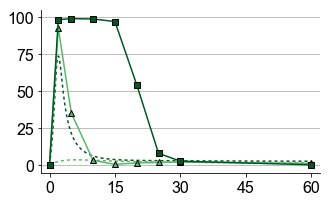

In [33]:
plotting.plt_param_cis(model_fxns, [d_alpha], params_constants, initials,  wt_doses, time, 2,
                        exp_data=mapk_wt_data, exp_time=mapk_time, ss=True, t100a=False, ptpD=False, ci='sd',
                         save_fig='', save_as='')

In [49]:
d_alpha_score = model_supp.calc_sim_score(model_fxns, d_alpha, exp_data, exp_time, params_constants, initials )

[1013.03115252 2937.36816538    0.            0.            0.
    0.            0.          274.08327166 2588.69808196  401.53114962
    0.            0.            0.            0.          207.5403657
 1200.88352969 1313.84878355  744.36963    3172.99634097 2746.93324008
  911.27813795  394.81693183  364.86030894]
Hog1 fit to WT: 3950.3993178998126
Hog1 fit to T100A: 3264.312503242326
Pbs2 fit to WT: 1408.4238953877414
Pbs2 fit to T100A: 2058.218413547018
Hog1 fit to Ramp: 3172.996340967754
Hog1 fit to PtpD: 4417.888618799188


In [54]:
i_alpha = step_size(best_param_set,0,10)
i_alpha_score = model_supp.calc_sim_score(model_fxns, i_alpha, exp_data, exp_time, params_constants, initials )

[6.02572414e+03 3.29874740e+03 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 0.00000000e+00 6.58907391e+02
 3.79423898e+02 4.71529857e+01 0.00000000e+00 0.00000000e+00
 0.00000000e+00 0.00000000e+00 5.87631446e+02 1.45746955e+03
 1.32940953e+02 7.03075984e+01 3.14342319e+03 1.09382192e+04
 2.15895130e+05 9.18790381e+05 2.38549246e+06]
Hog1 fit to WT: 9324.471536603041
Hog1 fit to T100A: 1085.4842752477641
Pbs2 fit to WT: 2045.100991094914
Pbs2 fit to T100A: 203.2485511418089
Hog1 fit to Ramp: 3143.423188804783
Hog1 fit to PtpD: 3531116.189099377


<function matplotlib.pyplot.loglog(*args, **kwargs)>

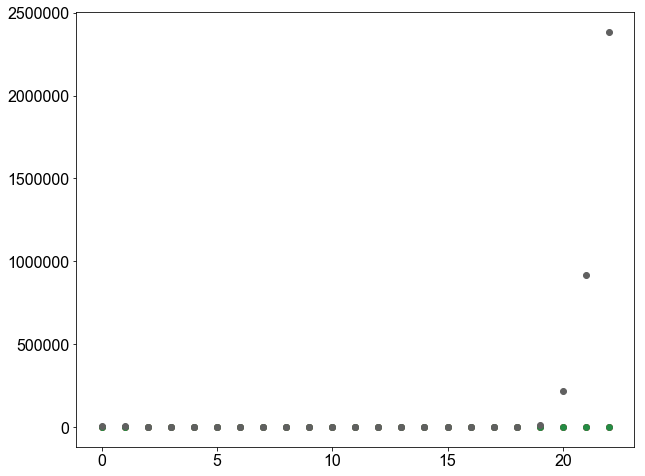

In [56]:
plt.plot(best_score, 'o')
plt.plot(d_alpha_score, 'o')
plt.plot(i_alpha_score, 'o')

In [811]:
def scan_param(param_vec, param_to_change, scan_range):
    scores = []
    for x in scan_range:
        _param = step_size(param_vec,param_to_change,x)
        _score = model_supp.calc_sim_score(model_fxns, _param, exp_data, exp_time, params_constants, initials )
        scores.append(_score)
    return np.array(scores)


test_range = np.logspace(-2,2,num=10)
test = scan_param(best_param_set, 0, test_range)

In [115]:
# get rid of columns of 0's (aka not fitting to a certain dataset)
print(test.shape)
test2 = test.copy()
test3 = test2.T[~np.all(test2.T == 0., axis=1)]
test3 = test3.T
print(test3.shape)

(10, 23)
(10, 14)


### MSE vs dataset for 1 param

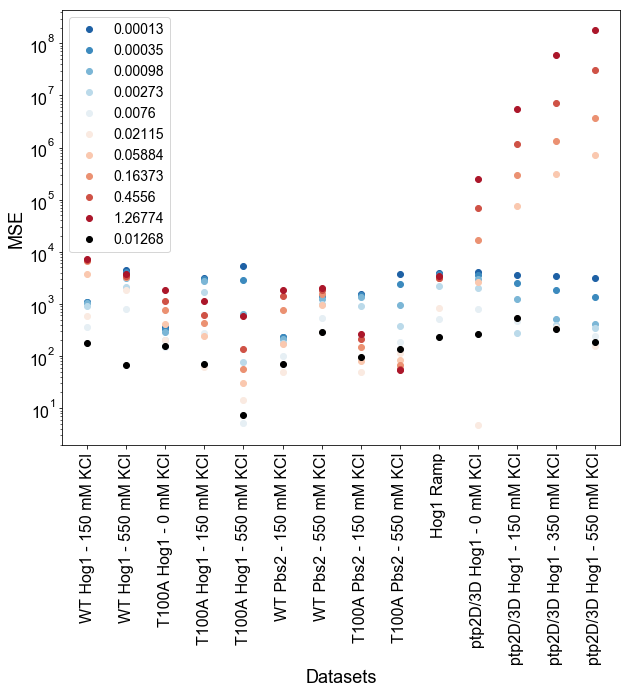

In [120]:
pal = sns.color_palette("RdBu_r", 10)
xlabels = ['WT Hog1 - 150 mM KCl', 
           'WT Hog1 - 550 mM KCl',
          'T100A Hog1 - 0 mM KCl',
          'T100A Hog1 - 150 mM KCl',
          'T100A Hog1 - 550 mM KCl',
          'WT Pbs2 - 150 mM KCl',
          'WT Pbs2 - 550 mM KCl',
          'T100A Pbs2 - 150 mM KCl',
          'T100A Pbs2 - 550 mM KCl',
          'Hog1 Ramp',
          'ptp2D/3D Hog1 - 0 mM KCl',
          'ptp2D/3D Hog1 - 150 mM KCl',
          'ptp2D/3D Hog1 - 350 mM KCl',
          'ptp2D/3D Hog1 - 550 mM KCl'
          ]
best_score_n0 = best_score[best_score != 0] 

for y, r, p in zip(test3, test_range,pal):
    plt.plot(xlabels,y, 'o', label = np.around(r*best_param_set[0],5), color = p)

plt.plot(best_score_n0, 'o', color='black', label = np.around(best_param_set[0], 5))
plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('MSE')
plt.xlabel('Datasets')
plt.legend()


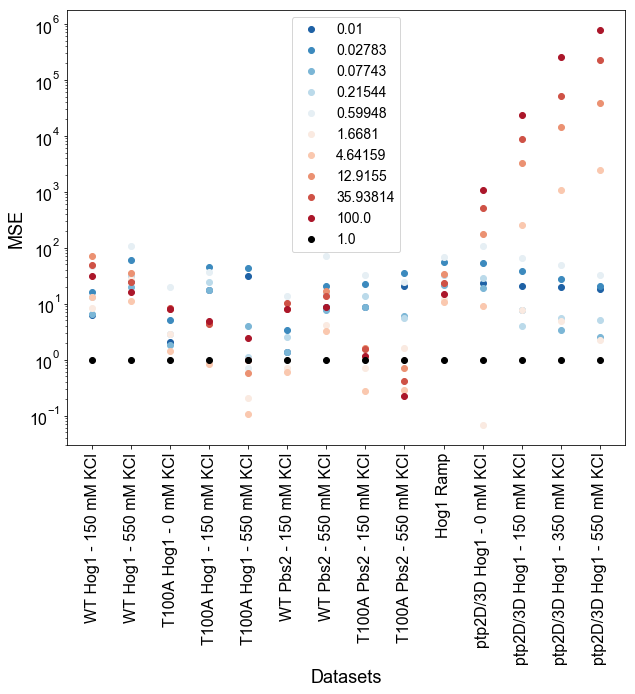

In [123]:
for y, r, p, n0 in zip(test3, test_range,pal,best_score_n0):
    plt.plot(xlabels,y/n0, 'o', label = np.around(r,5), color = p)

plt.plot(best_score_n0/best_score_n0, 'o', color='black', label = np.around(best_param_set[0]/best_param_set[0], 5))
plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('MSE')
plt.xlabel('Datasets')
plt.legend()

### total MSE vs $\Delta p$ for 1 param

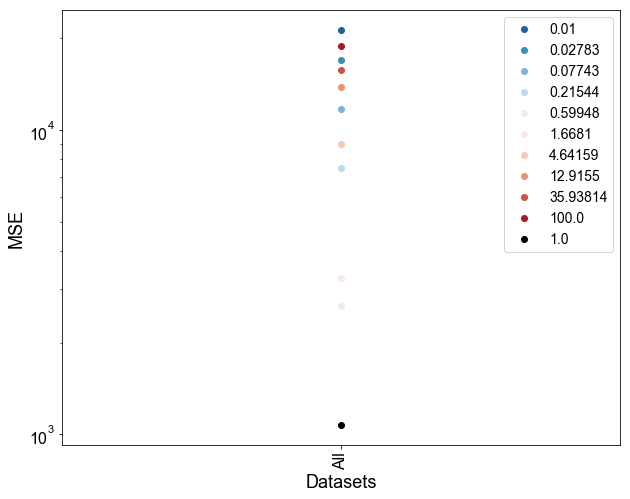

In [184]:
for y, r, p in zip(test,test_range,pal):    
    plt.plot(['All'],sum(y[:18]), 'o', label = np.around(r,5), color = p)

plt.plot(sum(best_score[:18]), 'o', color='black', label = np.around(best_param_set[0]/best_param_set[0], 5))
plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('MSE')
plt.xlabel('Datasets')
plt.legend()

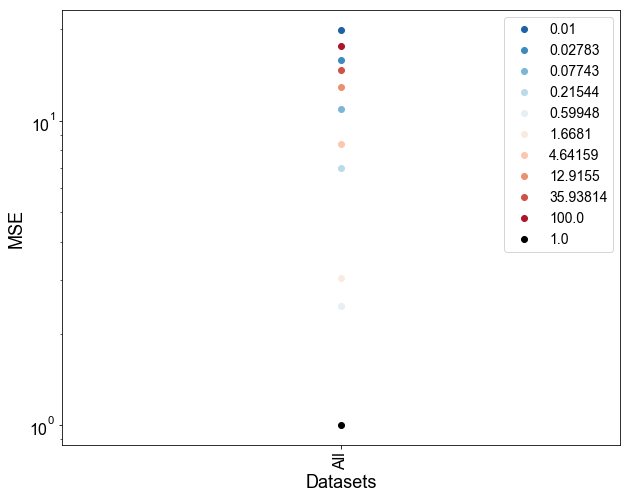

In [152]:
# normalized

for y, r, p in zip(test,test_range,pal):    
    plt.plot(['All'],sum(y[:18])/sum(best_score[:18]), 'o', label = np.around(r,5), color = p)

plt.plot(sum(best_score[:18])/sum(best_score[:18]), 'o', color='black', label = np.around(best_param_set[0]/best_param_set[0], 5))
plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('MSE')
plt.xlabel('Datasets')
plt.legend()

In [837]:
best_score

array([175.56910292,  67.20508042,   0.        ,   0.        ,
         0.        ,   0.        ,   0.        , 158.53466742,
        68.96123301,   7.45845581,   0.        ,   0.        ,
         0.        ,   0.        ,  69.9332911 , 290.24678715,
        94.59880962, 138.75046044, 233.52547619, 267.34296477,
       536.17851651, 334.75635243, 184.66633902])

#### Check ranges 

C:\Users\sksuzuki\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:3152: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=1e-05, right=1e-05
  'left=%s, right=%s') % (left, right))
C:\Users\sksuzuki\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:3152: UserWarning: Attempting to set identical left==right results
in singular transformations; automatically expanding.
left=1e-05, right=1e-05
  'left=%s, right=%s') % (left, right))


Text(0.5,0,'$\\Delta p$ (normalized to original value)')

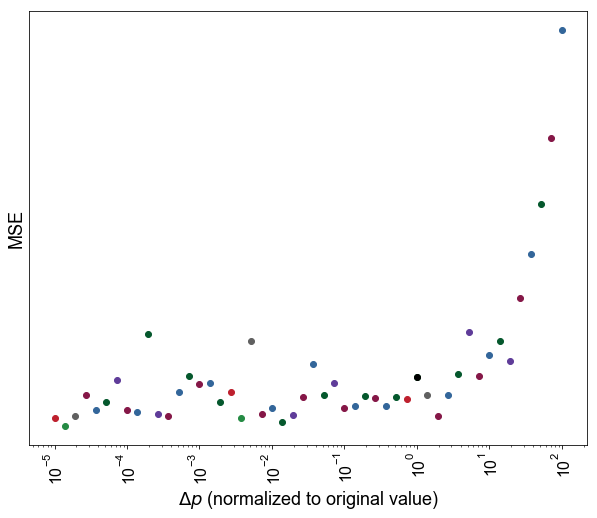

In [1011]:
num = 13
test_range = np.logspace(-5,2,num=50)
test = scan_param(best_param_set, num, test_range)

# for y, r, p in zip(test,test_range,pal):    
#     plt.loglog(r,sum(y[:18])+y[19], 'o', label = np.around(r*best_param_set[0],5), color = p)
for y, r in zip(test,test_range):    
    plt.loglog(r,sum(y[:18])+y[19], 'o', label = np.around(r*best_param_set[0],5))


plt.loglog(1, sum(best_score[:18])+best_score[19], 'o', color='black', label = np.around(best_param_set[num], 5))
# plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('MSE')
plt.xlabel('$\Delta p$ (normalized to original value)')
# plt.legend()

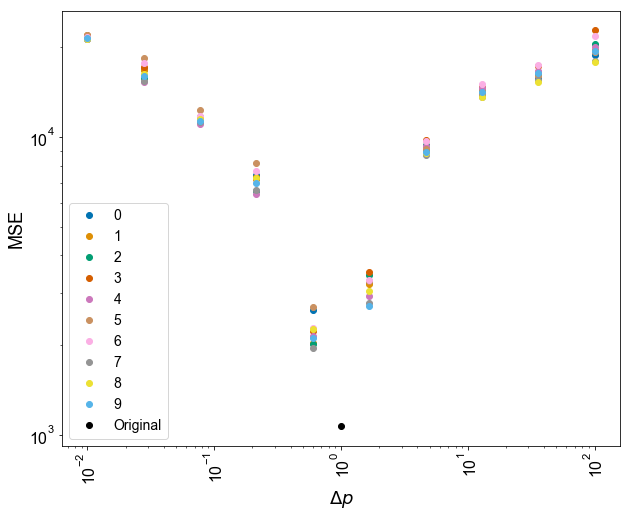

In [177]:
# param sets for p[0] - SMC

cpal = sns.color_palette("colorblind", 10)
for i, (pset, p) in enumerate(zip(thetas_e4_sort, cpal)):
    mses = scan_param(pset, 0, test_range)
    for y, r in zip(mses[:-1],test_range[:-1]):    
        plt.loglog(r,sum(y[:18]), 'o', color = p)
    plt.loglog(test_range[-1],sum(mses[-1][:18]), 'o', label = i, color = p)


plt.loglog(1, sum(best_score[:18]), 'o', color='black', label = 'Original')
# plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('MSE')
plt.xlabel('$\Delta p$')
plt.legend()

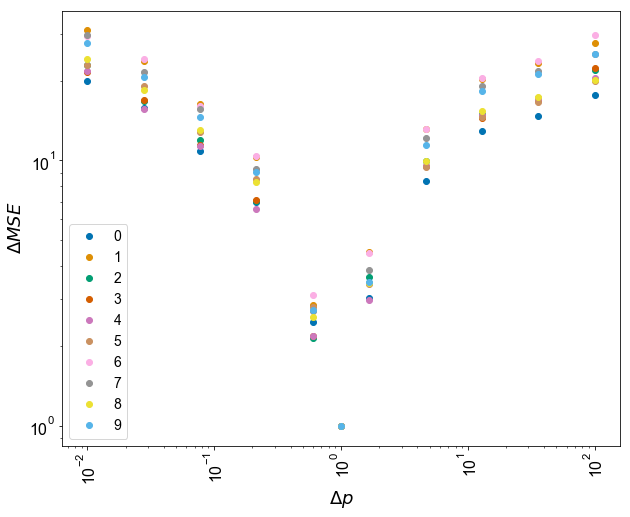

In [183]:
# param sets for p[0] - SMC normalized to original MSE

cpal = sns.color_palette("colorblind", 10)
for i, (pset, p) in enumerate(zip(thetas_e4_sort, cpal)):
    omse = sum(model_supp.calc_sim_score(model_fxns, pset, exp_data, exp_time, params_constants, initials )[:18])
    mses = scan_param(pset, 0, test_range)
    for y, r in zip(mses,test_range):    
        plt.loglog(r,sum(y[:18])/omse, 'o', color = p)
    plt.loglog(1,omse/omse, 'o', label = i, color = p)

# plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('$\Delta MSE$')
plt.xlabel('$\Delta p$')
plt.legend()

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


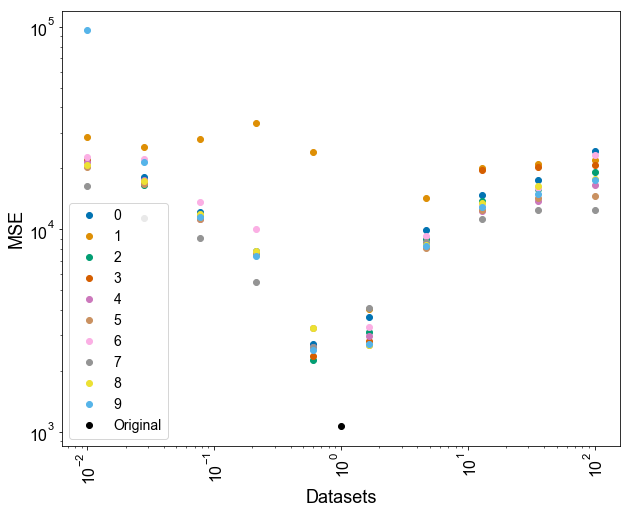

In [167]:
# # param sets for p[0] - EA

# cpal = sns.color_palette("colorblind", 10)
# for i, (pset, p) in enumerate(zip(sorted_thetas_EA, cpal)):
#     mses = scan_param(pset, 0, test_range)
#     for y, r in zip(mses[:-1],test_range[:-1]):    
#         plt.loglog(r,sum(y[:18]), 'o', color = p)
#     plt.loglog(test_range[-1],sum(mses[-1][:18]), 'o', label = i, color = p)


# # plt.loglog(1, sum(best_score[:18]), 'o', color='black', label = 'Original') this is the top of ABC SMC
# # plt.yscale('log')
# plt.xticks(rotation='vertical')
# plt.ylabel('MSE')
# plt.xlabel('Datasets')
# plt.legend()

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


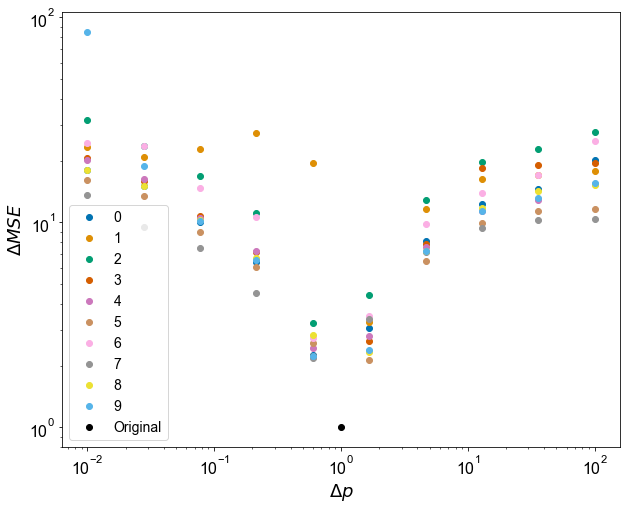

In [211]:
# param sets for p[0] - EA norm to original MSE

cpal = sns.color_palette("colorblind", 10)
for i, (pset, p) in enumerate(zip(sorted_thetas_EA,cpal)):
    mse = sum(model_supp.calc_sim_score(model_fxns, pset, exp_data, exp_time, params_constants, initials )[:18])
    dmses = scan_param(pset, 0, test_range)
    for y, r in zip(dmses[:-1],test_range[:-1]):    
        plt.loglog(r,sum(y[:18])/mse, 'o', color = p)
    plt.loglog(test_range[-1],sum(dmses[-1][:18])/mse, 'o', label = i, color = p)


plt.loglog(1, sum(best_score[:18])/sum(best_score[:18]), 'o', color='black', label = 'Original')
# plt.yscale('log')
# plt.xticks(rotation='vertical')
plt.ylabel('$\Delta MSE$')
plt.xlabel('$\Delta p$')
plt.legend()

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


Text(0.5,0,'$\\Delta p$')

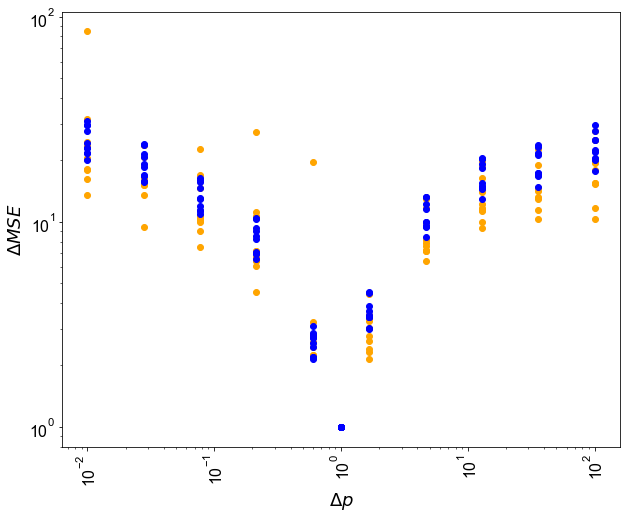

In [186]:
# param sets for p[0] - EA and SMC normalized to original MSE
# orange is EA
# blue is ABC SMC


cpal = sns.color_palette("colorblind", 10)
for i, (pset, p) in enumerate(zip(sorted_thetas_EA,cpal)):
    mse = sum(model_supp.calc_sim_score(model_fxns, pset, exp_data, exp_time, params_constants, initials )[:18])
    dmses = scan_param(pset, 0, test_range)
    for y, r in zip(dmses[:-1],test_range[:-1]):    
        plt.loglog(r,sum(y[:18])/mse, 'o', color = 'orange')
    plt.loglog(test_range[-1],sum(dmses[-1][:18])/mse, 'o', label = i, color='orange')


# plt.loglog(1, sum(best_score[:18])/sum(best_score[:18]), 'o', color='black', label = 'Original')

for i, (pset, p) in enumerate(zip(thetas_e4_sort, cpal)):
    omse = sum(model_supp.calc_sim_score(model_fxns, pset, exp_data, exp_time, params_constants, initials )[:18])
    mses = scan_param(pset, 0, test_range)
    for y, r in zip(mses,test_range):    
        plt.loglog(r,sum(y[:18])/omse, 'o', color = 'blue')
    plt.loglog(1,omse/omse, 'o', label = i, color = 'blue')

# plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('$\Delta MSE$')
plt.xlabel('$\Delta p$')
# plt.legend()

### param vs $\Delta p$ w.r.t total MSE for best param

#### ABC SMC

In [830]:
#ABC SMC

original_mses = []
data = []
for param in range(len(best_param_set)):
    sim_score = model_supp.calc_sim_score(model_fxns, best_param_set, exp_data, exp_time, params_constants, initials )
    mse = sum(sim_score[:18])+ sim_score[19]
    original_mses.append(mse)
    
    mses = scan_param(best_param_set, param, test_range)
    t_mse = [sum(x[:18])+x[19] for x in mses]
    data.append(t_mse)
    


C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\o

In [947]:
def scan_param_plus(param_vec, param_to_change, scan_range):
    scores = []
#     print(scan_range)
    for x in scan_range:
        _param = step_size_plus(param_vec,param_to_change,x)
        _score = model_supp.calc_sim_score(model_fxns, _param, exp_data, exp_time, params_constants, initials )
#         print(_score)
        scores.append(_score)
    return np.array(scores)

def step_size_plus(param_vec, param_to_change, step_size):
    #step_size as a percentage of the param value
    param_ = param_vec.copy()
    param_[param_to_change] = param_[param_to_change]+step_size*param_[param_to_change]
    return param_

In [922]:
# test_range_sm = np.logspace(-1,1,num=2)
dp = .01
mses_t = scan_param_plus(best_param_set, 0, [dp, -dp])
t_mse_t = [sum(x[:18])+x[19] for x in mses_t]
print(t_mse_t)

[184.74253826  67.83623645   0.           0.           0.
   0.           0.         159.07368647  67.35610927   7.56618425
   0.           0.           0.           0.          69.36677292
 287.36483556  92.96412679 138.0932948  239.62100535 258.91444824
 536.39764539 334.41410832 183.79367483]
[167.14176429  68.05850858   0.           0.           0.
   0.           0.         158.00230922  70.65859032   7.35112871
   0.           0.           0.           0.          70.50793772
 293.25375774  96.28699837 139.42100758 228.5231718  275.9536741
 535.94122913 335.11376121 185.55823576]
[1333.2782330266518, 1346.635676641325]


In [861]:
# 
# sum_mse = (t_mse_t[0]*(best_param_set[0]+(.005))
#            -t_mse_t[1]*(best_param_set[0]-(.005)))/original_mses[0]/(2*.005/best_param_set[0])

# print(sum_mse)

sum_mse = ((t_mse_t[0]-t_mse_t[1])/original_mses[0])/(2*dp/best_param_set[0])

print(sum_mse)

# sum_mse = (t_mse_t[0]-t_mse_t[1])/original_mses[0]/(2*.005/best_param_set[0])

# print(sum_mse)
# ax = sns.barplot(labelnames, np.log10(sum_mse))
# ax.set(xticklabels=labelnames)
# plt.xticks(rotation=45)
# plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
# plt.axhline(y=1, color = 'grey')
# plt.ylabel('Normalized Sensitivity Score')
# plt.show()

-0.3048275520989173


In [957]:
def sensitivity_analysis2(param_set,pred=False):
    sa_values = []
    for param_s in param_set:
        original_mses = 0
        data = []
        mse = model_supp.calc_sim_score(model_fxns, param_s, exp_data, exp_time, params_constants, initials)
        if pred:
            _mse = mse[18]
        else:
            _mse = sum(mse[:18])+mse[19]
        original_mses = [_mse]
#         print(original_mses)
        for param in range(len(param_s)):
            
            mses = scan_param_plus(param_s, param, [dp])
            if pred:
                t_mse = [x[18] for x in mses]
            else:
                t_mse = [(sum(x[:18])+x[19]-_mse)/(dp)/_mse for x in mses] #*param/(dp*param) 
            data.append(t_mse)
#             print(dp*param)
            print(t_mse, dp*param_s[param])
        sum_mse = np.sum(np.array(data), axis = 1)/np.array(original_mses*len(param_s))
        sa_values.append(sum_mse)
    return np.array(sa_values)

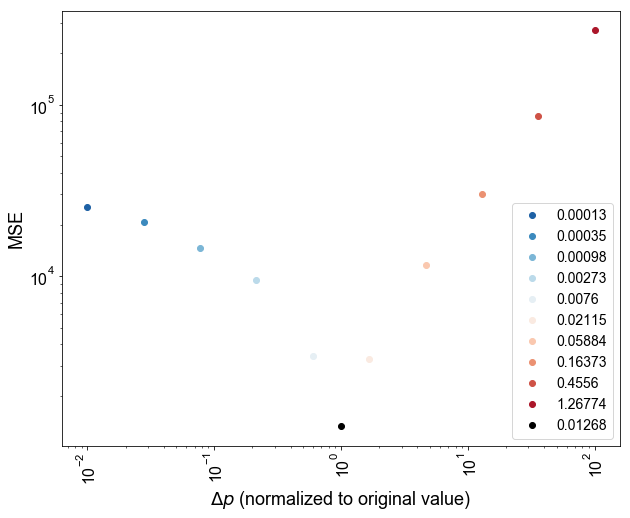

In [964]:
for y, r, p in zip(test,test_range,pal):    
    plt.loglog(r,sum(y[:18])+y[19], 'o', label = np.around(r*best_param_set[0],5), color = p)

plt.loglog(1, sum(best_score[:18])+best_score[19], 'o', color='black', label = np.around(best_param_set[0], 5))
# plt.yscale('log')
plt.xticks(rotation='vertical')
plt.ylabel('MSE')
plt.xlabel('$\Delta p$ (normalized to original value)')
plt.legend()

In [961]:
dp = 0.01
test_sa2 = sensitivity_analysis2([best_param_set])

[-0.39762559830611144] 0.0001267735773723447
[0.02363903418246959] 71.1484383372588
[-0.3260766645500766] 1179240.378268967
[-0.0739192049234301] 65.45172773434652
[-0.17186247225935183] 0.0011886836198745352
[-1.7646372196464837] 0.008362933534390852
[-0.23372170664147465] 81.2846152769717
[0.5933647803999567] 0.0011873811540446528
[0.010114209749134545] 0.9519998574031313
[0.5155060778092359] 2.352313734879441
[1.1070251875193973] 0.01290620047381091
[0.627656148811195] 25.69804958754392
[-0.5139602123948259] 6.053260200455277e-05
[-4.0740459330845535e-05] 7.967426220192261e-07
[0.5046957069767192] 0.0017414126679684784
[0.0029922311103585215] 8.964476565076152e-07
[0.033166014234398807] 3.0335038565835526e-05
[0.024757353744053336] 0.0011060400586872282
[-0.3009045491651295] 6.392379051187309e-06
[-0.9879558679779916] 0.03846565081825711
[-0.2325488318099715] 12.10740781364221
[0.011019825988978856] 0.0068916416913668245


In [915]:
test_sa2

array([[        nan, 10.16252464, 10.33237632, 10.16222316, 11.44019718,
        10.65506565, 10.37252601, 11.0321935 , 10.16553334, 11.12112186,
        10.54964371, 10.00440734, 10.36296127,  9.99999847, 10.94313856,
        10.00000433, 10.00077759, 10.1290151 , 10.1407662 , 10.62422153,
        10.3723403 , 10.1628784 ]])

In [ ]:
# 
sum_mse = np.sum(np.array(data), axis = 1)/np.array(original_mses)

ax = sns.barplot(labelnames, np.log10(sum_mse))
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

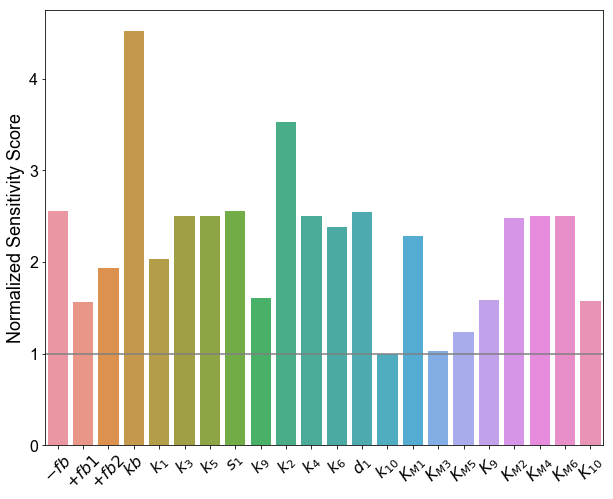

In [831]:
# EA trained
sum_mse = np.sum(np.array(data), axis = 1)/np.array(original_mses)

ax = sns.barplot(labelnames, np.log10(sum_mse))
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

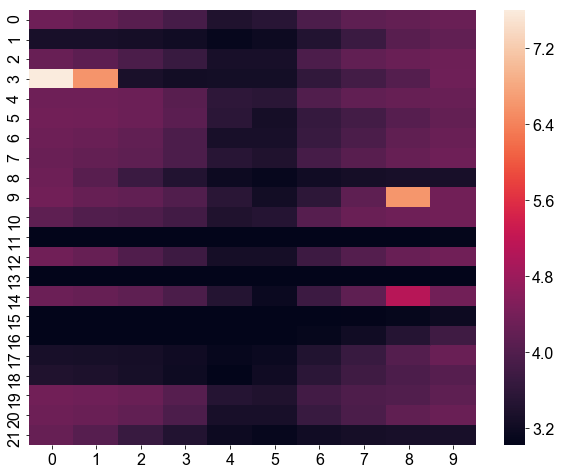

In [235]:
# sns.heatmap(np.log10(np.array(data)))

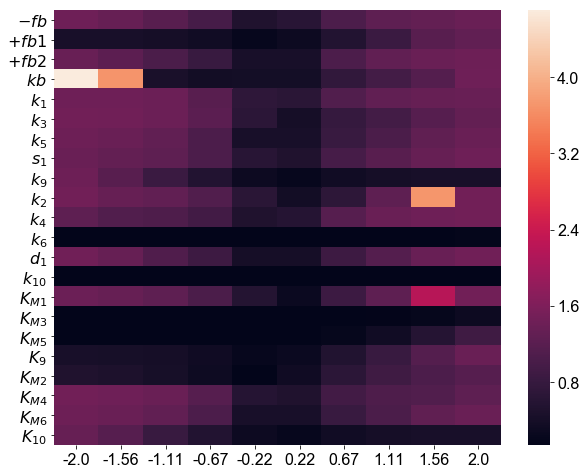

In [230]:
# normalized
ax = sns.heatmap(np.log10(np.array(data)/np.array(original_mses)[:, np.newaxis] ))
ax.set(xticklabels=np.around(np.log10(test_range),2), yticklabels=labelnames)
# plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')

plt.show()

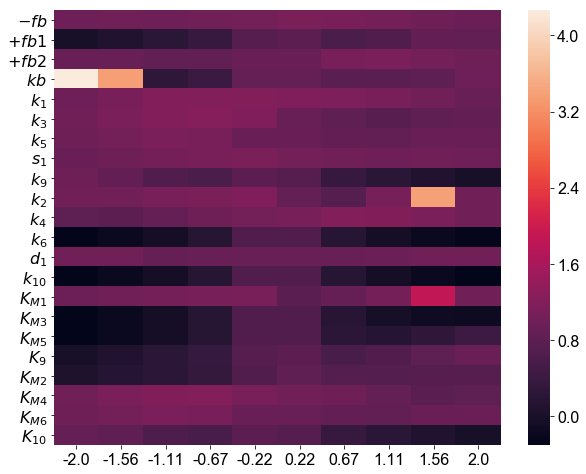

In [236]:
#normalized to delta p
# ax = sns.heatmap(np.log10(np.array(data)/np.array(original_mses)[:, np.newaxis]/np.abs(np.log10(test_range))))
# ax.set(xticklabels=np.around(np.log10(test_range),2), yticklabels=labelnames)
# # plt.xticks(rotation='vertical')
# plt.yticks(rotation='horizontal')

# plt.show()

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:2

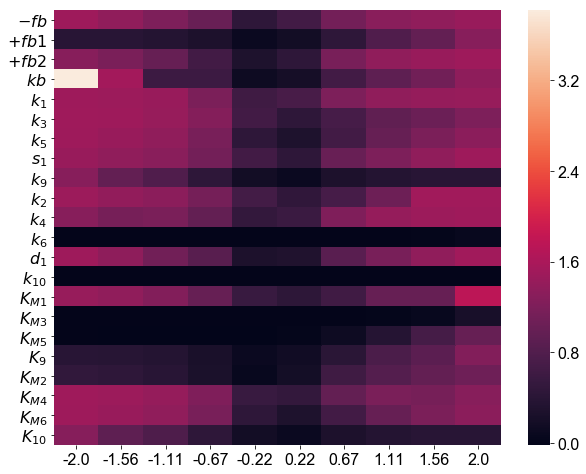

In [243]:
num=1
original_mses = []
data = []
for param in range(len(thetas_e4_sort[num])):
    mse = sum(model_supp.calc_sim_score(model_fxns, thetas_e4_sort[num], exp_data, exp_time, params_constants, initials )[:18])
    original_mses.append(mse)
    
    mses = scan_param(thetas_e4_sort[num], param, test_range)
    t_mse = [sum(x[:18]) for x in mses]
    data.append(t_mse)

ax = sns.heatmap(np.log10(np.array(data)/np.array(original_mses)[:, np.newaxis] ))
ax.set(xticklabels=np.around(np.log10(test_range),2), yticklabels=labelnames)
# plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')

plt.show()

#### EA

##### Correlation matrix

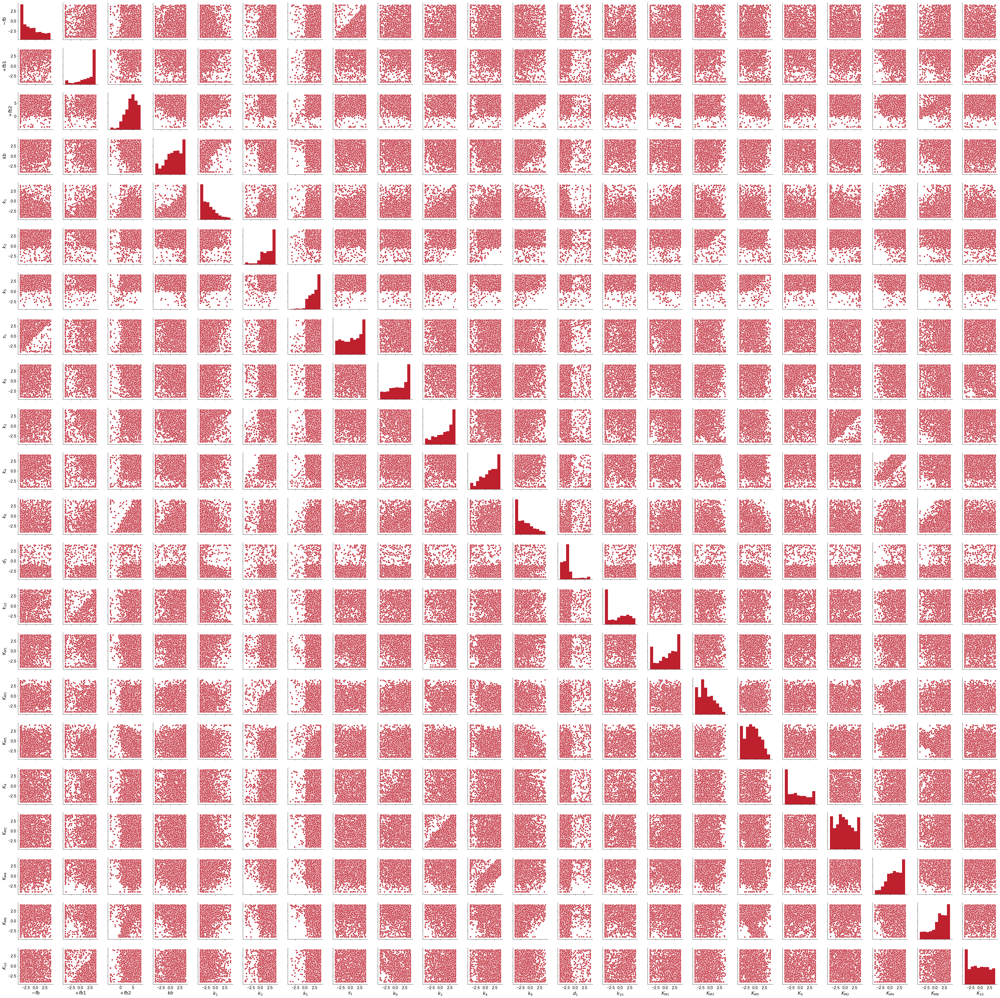

In [291]:
# all simulation data
sns.pairplot(np.log10(df_top_thetas_EA))

#### Weighted correlation

No handles with labels found to put in legend.


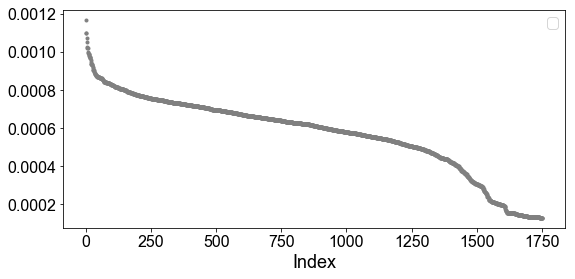

In [326]:
w_i = 1/sorted_mses_EA/np.sum(sorted_mses_EA)/np.sum(1/sorted_mses_EA/np.sum(sorted_mses_EA)) #vector of weights for each sample (sorted)

plotting.plt_pdf(w_i, len(sorted_mses_EA))

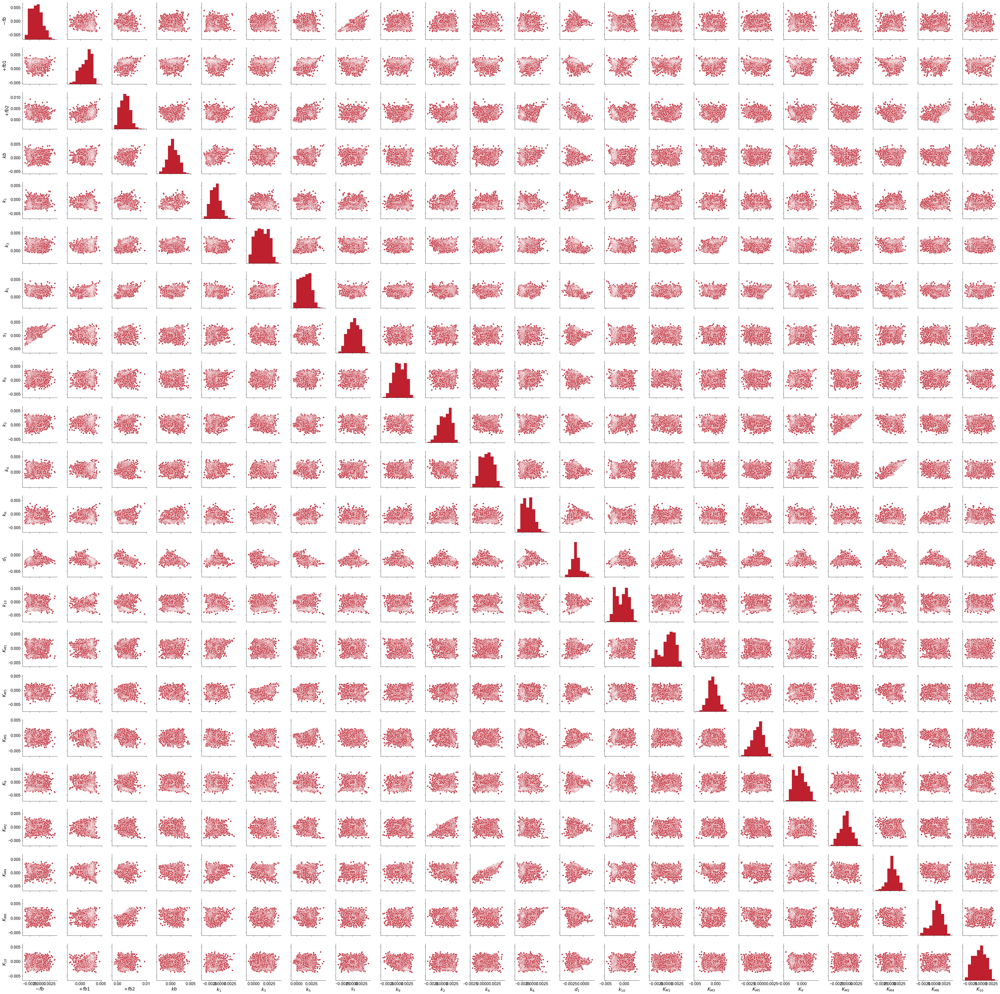

In [355]:
theta_w = pd.DataFrame(np.array(np.log10(df_top_thetas_EA))*w_i[:, np.newaxis], columns = labelnames)
sns.pairplot(theta_w)

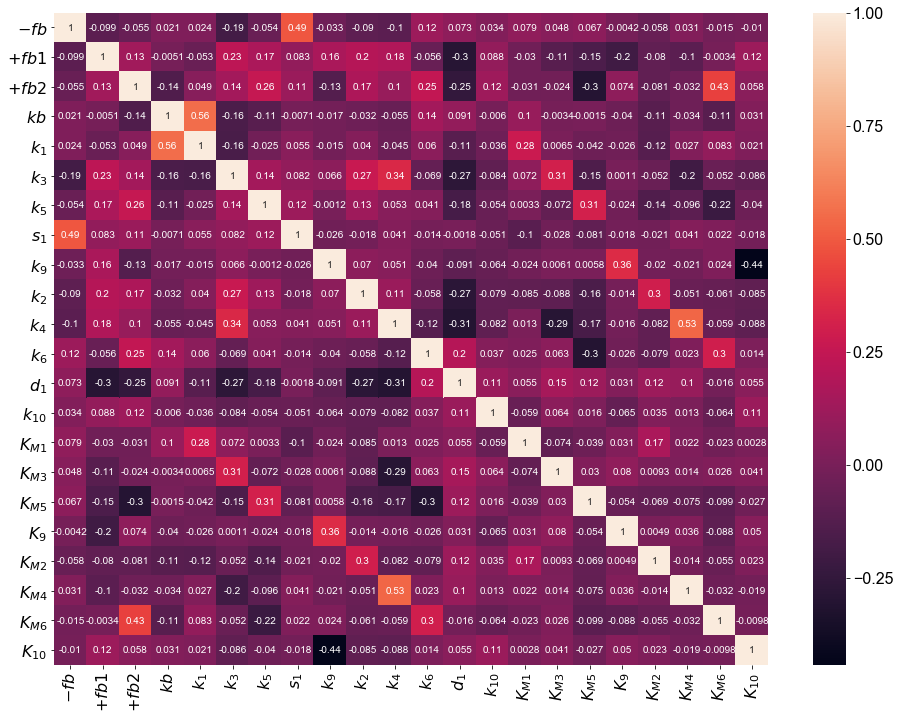

In [366]:
# unweighted correlation matrix
f, ax = plt.subplots(figsize=(16,12))
ax = sns.heatmap(pd.DataFrame(np.corrcoef(np.log10(df_top_thetas_EA).T), columns=labelnames, index = labelnames), annot=True, annot_kws={'size':10})

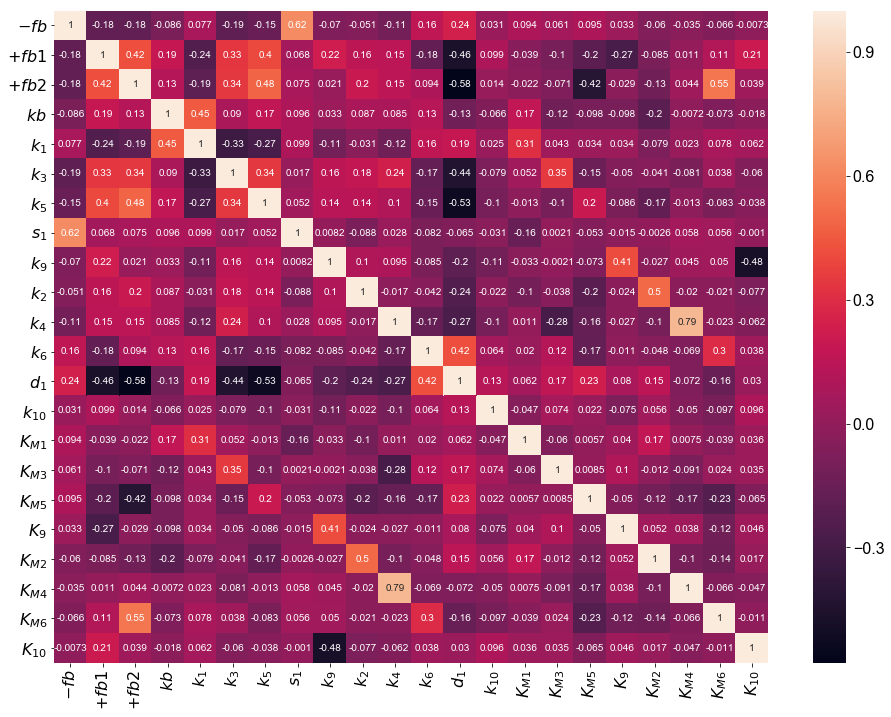

In [370]:
# weighted correlation maxtrix

f, ax = plt.subplots(figsize=(16,12))
corr_w = pd.DataFrame(np.corrcoef(theta_w.T), columns=labelnames, index = labelnames)
ax = sns.heatmap(corr_w, annot=True, annot_kws={'size':10})

In [393]:
def corr_params(corr_m_df, t):
    return np.sum(np.abs(corr_w)[np.abs(corr_w) > t].count())

print("Number of high correlations: " + str((corr_params(corr_w, .5)-22)/2))
print("Number of moderate correlations: " + str((corr_params(corr_w, .3)-22-corr_params(corr_w, .5))/2))
print("Number of low correlations: " + str((corr_params(corr_w, .1)-22-corr_params(corr_w, .5)-corr_params(corr_w, .3))/2))
print("of " + str((len(labelnames)**2-len(labelnames))/2))

Number of high correlations: 6.0
Number of moderate correlations: 5.0
Number of low correlations: 47.0
of 231.0


In [249]:
# EA
original_mses_ea = []
data_ea = []
for param in range(len(sorted_thetas_EA[0])):
    mse = sum(model_supp.calc_sim_score(model_fxns, sorted_thetas_EA[0], exp_data, exp_time, params_constants, initials )[:18])
    original_mses_ea.append(mse)
    
    mses = scan_param(sorted_thetas_EA[0], param, test_range)
    t_mse = [sum(x[:18]) for x in mses]
    data_ea.append(t_mse)
    

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


In [419]:
# EA
original_mses_ea = []
data_ea = []
for param in range(len(sorted_thetas_EA[0])):
    mse = sum(model_supp.calc_sim_score(model_fxns, sorted_thetas_EA[0], exp_data, exp_time, params_constants, initials )[:18])+model_supp.calc_sim_score(model_fxns, sorted_thetas_EA[0], exp_data, exp_time, params_constants, initials )[19]
    original_mses_ea.append(mse)
    
    mses = scan_param(sorted_thetas_EA[0], param, test_range)
    t_mse = [sum(x[:18])+x[19] for x in mses]
    data_ea.append(t_mse)
    

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


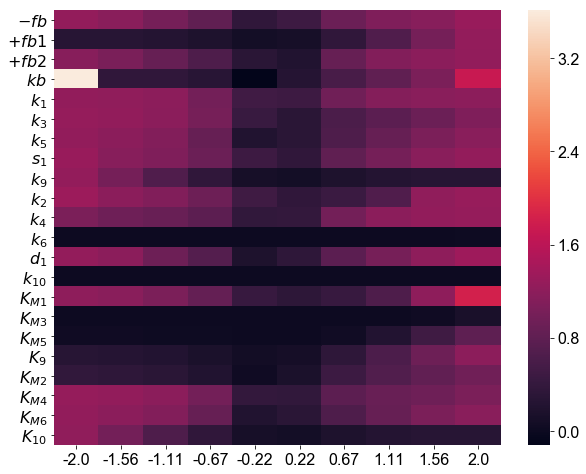

In [287]:
# normalized EA - trained 
heat_data = np.log10(np.array(data_ea)/np.array(original_mses_ea)[:, np.newaxis] )
sum_mse = np.log(np.sum(np.array(data_ea), axis = 1)/np.array(original_mses_ea))
# heat_data = np.concatenate((heat_data, np.reshape(sum_mse, (-1, 1))), axis = 1)

ax = sns.heatmap(heat_data)
ax.set(xticklabels=np.around(np.log10(test_range),2), yticklabels=labelnames)
# plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')

plt.show()

In [ ]:
# EA trained
sum_mse = np.sum(np.array(data_ea), axis = 1)/np.array(original_mses_ea)

ax = sns.barplot(labelnames, np.log10(sum_mse))
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

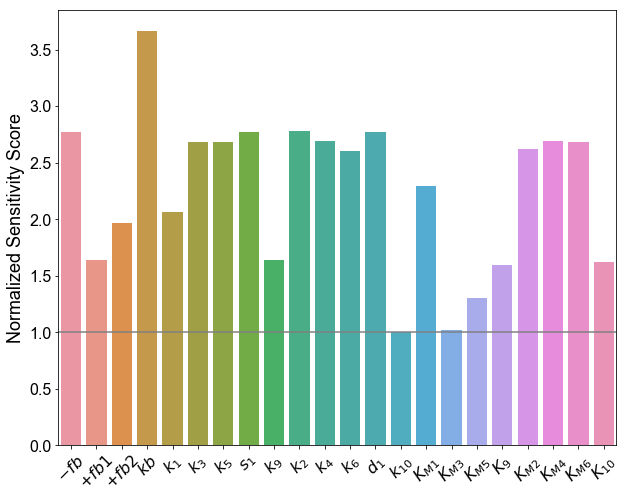

In [420]:
# EA trained
sum_mse = np.sum(np.array(data_ea), axis = 1)/np.array(original_mses_ea)

ax = sns.barplot(labelnames, np.log10(sum_mse))
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


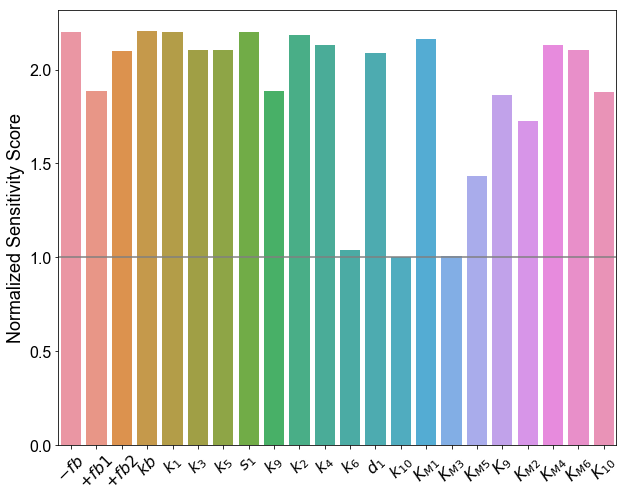

In [421]:
# EA prediction
original_mses_ea = []
data_ea = []
for param in range(len(sorted_thetas_EA[0])):
    mse = model_supp.calc_sim_score(model_fxns, sorted_thetas_EA[0], exp_data, exp_time, params_constants, initials )[18]
    original_mses_ea.append(mse)
    
    mses = scan_param(sorted_thetas_EA[0], param, test_range)
    t_mse = [x[18] for x in mses]
    data_ea.append(t_mse)

sum_mse = np.sum(np.array(data_ea), axis = 1)/np.array(original_mses_ea)

ax = sns.barplot(labelnames, np.log10(sum_mse))
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

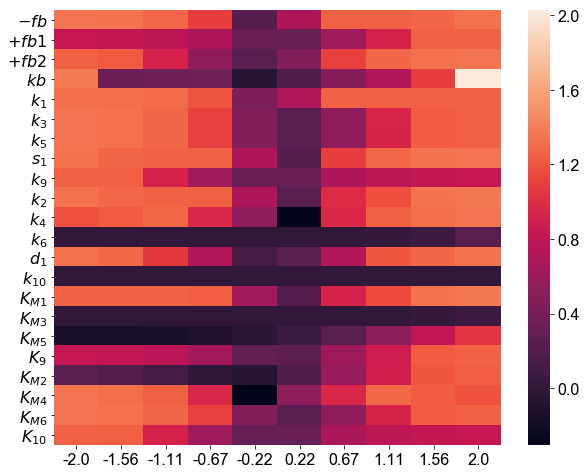

In [422]:
# EA predition
heat_data = np.log10(np.array(data_ea)/np.array(original_mses_ea)[:, np.newaxis] )
sum_mse = np.log(np.sum(np.array(data_ea), axis = 1)/np.array(original_mses_ea))
# heat_data = np.concatenate((heat_data, np.reshape(sum_mse, (-1, 1))), axis = 1)

ax = sns.heatmap(heat_data)
ax.set(xticklabels=np.around(np.log10(test_range),2), yticklabels=labelnames)
# plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')

plt.show()

In [413]:
# EA
original_mses_ea = []
data_ea = []
for param in range(len(sorted_thetas_EA[0])):
    mse = sum(model_supp.calc_sim_score(model_fxns, sorted_thetas_EA[1], exp_data, exp_time, params_constants, initials )[:18])
    original_mses_ea.append(mse)
    
    mses = scan_param(sorted_thetas_EA[1], param, test_range)
    t_mse = [sum(x[:18]) for x in mses]
    data_ea.append(t_mse)
    

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)


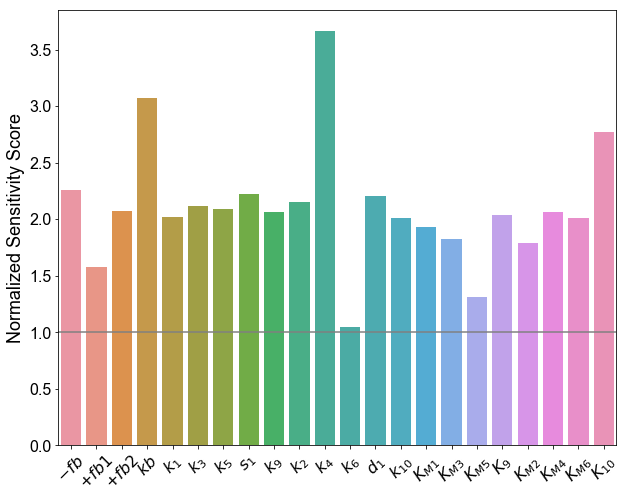

In [415]:
heat_data = np.log10(np.array(data_ea)/np.array(original_mses_ea)[:, np.newaxis] )
sum_mse = np.sum(np.array(data_ea), axis = 1)/np.array(original_mses_ea)

ax = sns.barplot(labelnames, np.log10(sum_mse))
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

# Local sensitivity Analysis

In [429]:
def sensitivity_analysis(param_set,pred=False):
    sa_values = []
    for param_s in param_set:
        original_mses = []
        data = []
        mse = model_supp.calc_sim_score(model_fxns, param_s, exp_data, exp_time, params_constants, initials)
        for param in range(len(param_s)):
            if pred:
                _mse = mse[18]
            else:
                _mse = sum(mse[:18])+mse[19]
            original_mses.append(_mse)
            
            mses = scan_param(param_s, param, test_range)
            if pred:
                t_mse = [x[18] for x in mses]
            else:
                t_mse = [sum(x[:18])+x[19] for x in mses]
            
            data.append(t_mse)
            
        sum_mse = np.sum(np.array(data), axis = 1)/np.array(original_mses)
        sa_values.append(sum_mse)
    return np.array(sa_values)

In [430]:
sa_values_ea = sensitivity_analysis(sorted_thetas_EA,pred=False)

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Repeated convergence failures (perhaps bad Jacobian or tolerances). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\o

C:\Users\sksuzuki\Anaconda3\lib\site-packages\numpy\core\_methods.py:29: RuntimeWarning: invalid value encountered in reduce
  return umr_minimum(a, axis, None, out, keepdims)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\numpy\core\_methods.py:26: RuntimeWarning: invalid value encountered in reduce
  return umr_maximum(a, axis, None, out, keepdims)


ValueError: max must be larger than min in range parameter.

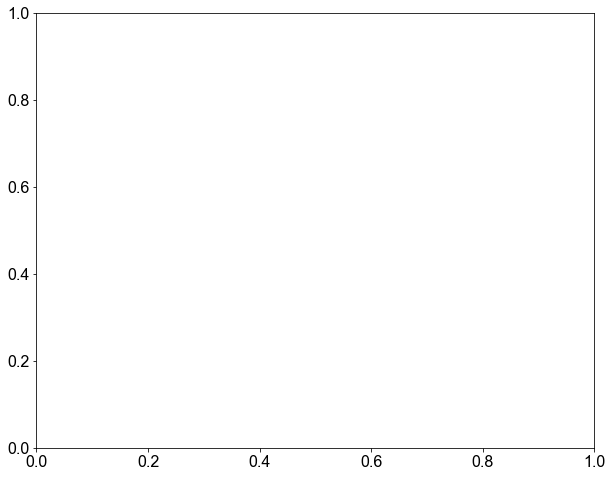

In [444]:
plt.hist(sa_values_ea[:, 2])

In [459]:
sa_df_ea.idxmax(axis=0)

$- fb$       225
$+ fb1$     1467
$+ fb2$     1538
$kb$        1251
$k_1$       1372
$k_3$        999
$k_5$       1372
$s_1$        901
$k_9$        608
$k_2$        901
$k_4$       1372
$k_6$       1384
$d_1$        901
$k_{10}$     608
$K_{M1}$     999
$K_{M3}$    1467
$K_{M5}$    1372
$K_9$        999
$K_{M2}$    1251
$K_{M4}$     901
$K_{M6}$     750
$K_{10}$     229
dtype: int64

In [463]:
test = sa_df_ea.copy()
test = test.where(test>1000, None)


In [464]:
test.isna().count()

$- fb$      1753
$+ fb1$     1753
$+ fb2$     1753
$kb$        1753
$k_1$       1753
$k_3$       1753
$k_5$       1753
$s_1$       1753
$k_9$       1753
$k_2$       1753
$k_4$       1753
$k_6$       1753
$d_1$       1753
$k_{10}$    1753
$K_{M1}$    1753
$K_{M3}$    1753
$K_{M5}$    1753
$K_9$       1753
$K_{M2}$    1753
$K_{M4}$    1753
$K_{M6}$    1753
$K_{10}$    1753
dtype: int64

In [467]:
sa_df_ea = pd.DataFrame(sa_values_ea, columns=labelnames)

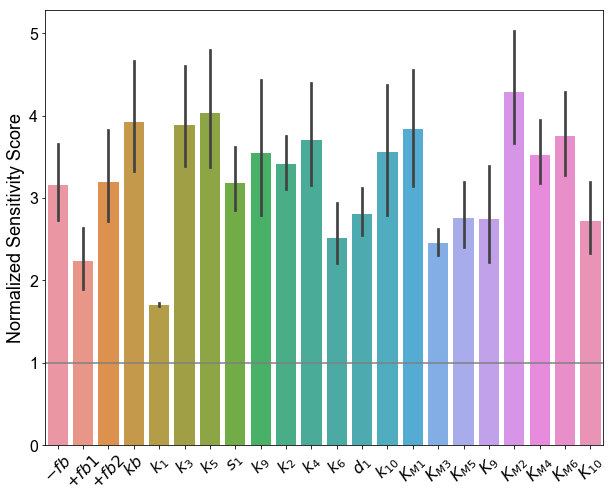

In [494]:
ax = sns.barplot(data = test2)
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

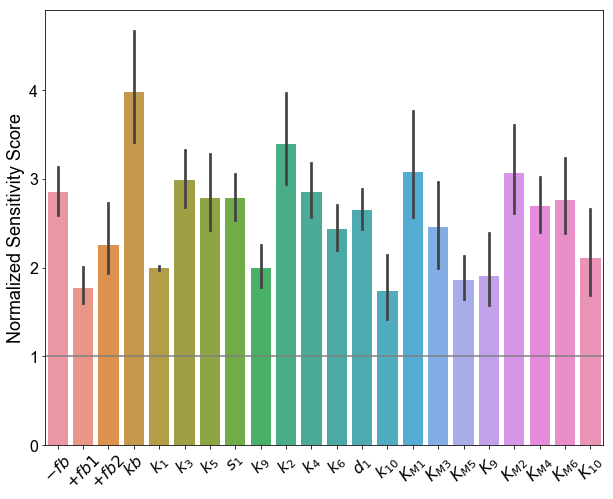

In [497]:
ax = sns.barplot(data = test2.loc[:100])
ax.set(xticklabels=labelnames)
plt.xticks(rotation=45)
plt.yticks(rotation='horizontal')
# plt.ylim(.5,4)
plt.axhline(y=1, color = 'grey')
plt.ylabel('Normalized Sensitivity Score')
plt.show()

In [493]:
# plt.hist(np.log10(sa_df_ea.iloc[:,7]))

test2 = np.log10(sa_df_ea)
test2 = test2.replace([np.inf, -np.inf], np.nan)

# plt.hist(test2.iloc[:,7])
test2.isnull().sum()
# test2.max()

$- fb$      0
$+ fb1$     0
$+ fb2$     1
$kb$        0
$k_1$       0
$k_3$       0
$k_5$       1
$s_1$       1
$k_9$       1
$k_2$       1
$k_4$       1
$k_6$       0
$d_1$       1
$k_{10}$    1
$K_{M1}$    0
$K_{M3}$    0
$K_{M5}$    0
$K_9$       1
$K_{M2}$    0
$K_{M4}$    0
$K_{M6}$    2
$K_{10}$    1
dtype: int64

In [433]:
np.savetxt('test_sensitivity_anal_ea.csv', sa_values_ea)

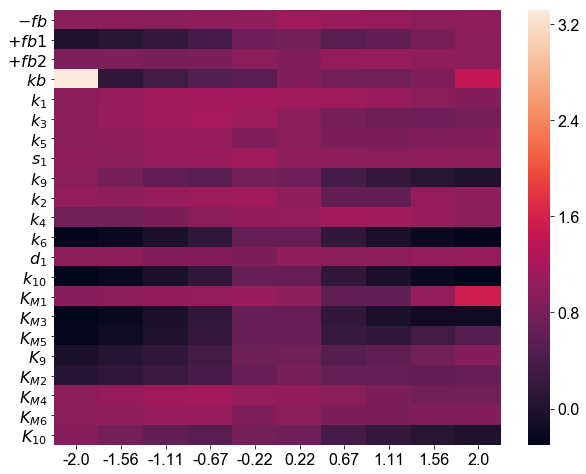

In [239]:
#normalized to delta p
ax = sns.heatmap(np.log10(np.array(data_ea)/np.array(original_mses_ea)[:, np.newaxis]/np.abs(np.log10(test_range))))
ax.set(xticklabels=np.around(np.log10(test_range),2), yticklabels=labelnames)
# plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')

plt.show()

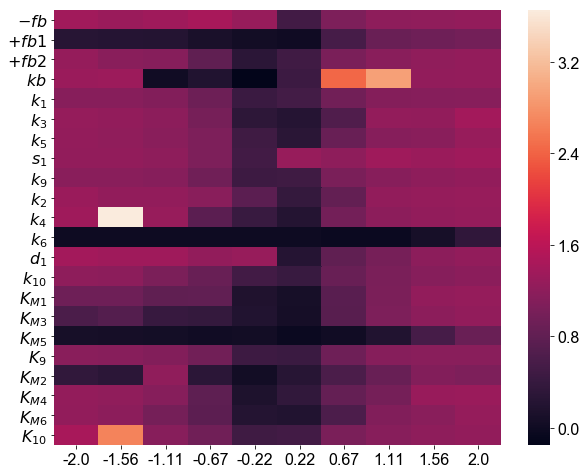

In [241]:
# EA
# num=1
# original_mses_ea = []
# data_ea = []
# for param in range(len(sorted_thetas_EA[num])):
#     mse = sum(model_supp.calc_sim_score(model_fxns, sorted_thetas_EA[num], exp_data, exp_time, params_constants, initials )[:18])
#     original_mses_ea.append(mse)
    
#     mses = scan_param(sorted_thetas_EA[num], param, test_range)
#     t_mse = [sum(x[:18]) for x in mses]
#     data_ea.append(t_mse)

ax = sns.heatmap(np.log10(np.array(data_ea)/np.array(original_mses_ea)[:, np.newaxis] ))
ax.set(xticklabels=np.around(np.log10(test_range),2), yticklabels=labelnames)
# plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')

plt.show()

C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\integrate\odepack.py:236: ODEintWarning: Excess work done on this call (perhaps wrong Dfun type). Run with full_output = 1 to get quantitative information.
  warnings.warn(warning_msg, ODEintWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The number of calls to function has reached maxfev = 1200.
  warnings.warn(msg, RuntimeWarning)
C:\Users\sksuzuki\Anaconda3\lib\site-packages\scipy\optimize\minpack.py:163: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last five Jacobian evaluations.
  warnings.warn(msg, RuntimeWarning)


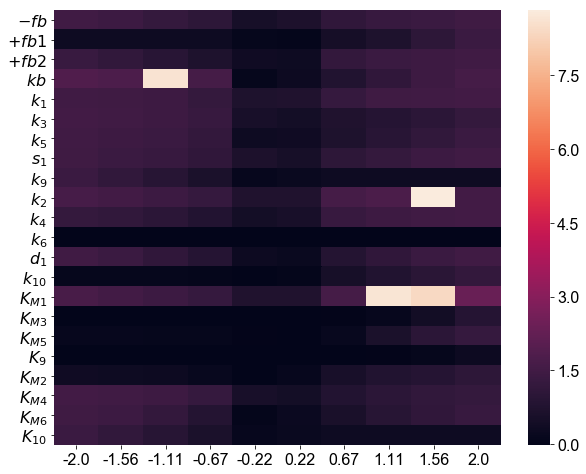

In [242]:
# EA
num=2
original_mses_ea = []
data_ea = []
for param in range(len(sorted_thetas_EA[num])):
    mse = sum(model_supp.calc_sim_score(model_fxns, sorted_thetas_EA[num], exp_data, exp_time, params_constants, initials )[:18])
    original_mses_ea.append(mse)
    
    mses = scan_param(sorted_thetas_EA[num], param, test_range)
    t_mse = [sum(x[:18]) for x in mses]
    data_ea.append(t_mse)

ax = sns.heatmap(np.log10(np.array(data_ea)/np.array(original_mses_ea)[:, np.newaxis] ))
ax.set(xticklabels=np.around(np.log10(test_range),2), yticklabels=labelnames)
# plt.xticks(rotation='vertical')
plt.yticks(rotation='horizontal')

plt.show()

## ABC SMC

In [ ]:
sa_values_smc = sensitivity_analysis(e4_thetas,pred=False)

# Global sensitivity analysis

In [710]:
from scipy.stats import norm

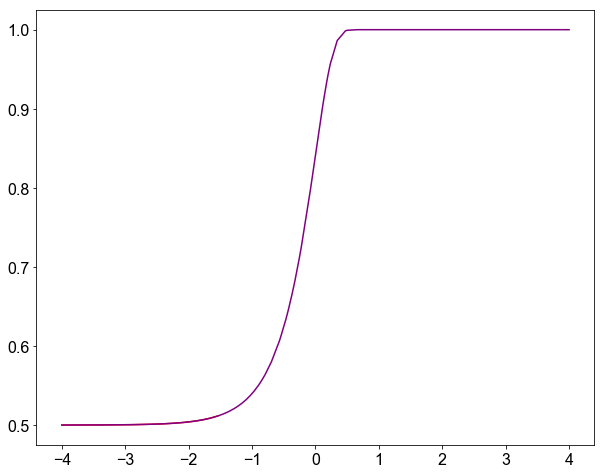

In [725]:
num = 12

good_cdf = norm.cdf(good[:,num])
bad_cdf = norm.cdf(bad[:,num])
sns.lineplot(x=np.log10(good[:,num]), y=good_cdf, color = 'red')
sns.lineplot(x=np.log10(bad[:,num]), y=bad_cdf, color = 'purple')

plt.show()

In [1048]:
## Worst EA MSEs (gen 0)
worst = np.array(pd.DataFrame(np.array(all_params)[:,0,:]).drop_duplicates())

In [1054]:
def plot_cdf_comp(num):
    good_cdf = norm.cdf(good[:,num])
    worst_cdf = norm.cdf(worst[:,num])
#     plt.plot(x=np.log10(good[:,num]), y=good_cdf, color = 'red')
#     plt.plot(x=np.log10(worst[:,num]), y=worst_cdf, color = 'purple')
    return good_cdf, worst_cdf
# plt.show()

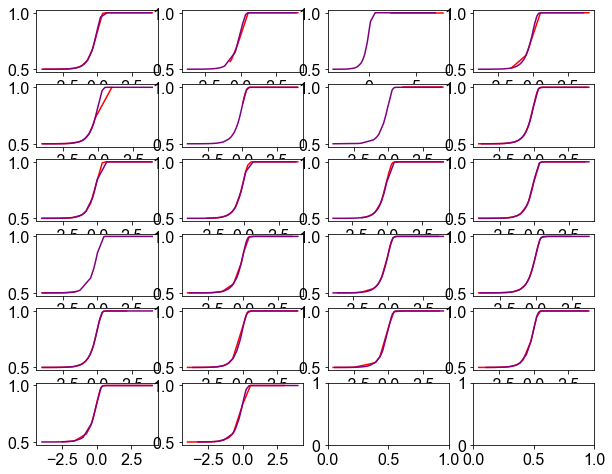

In [1055]:
fig, axs = plt.subplots(6, 4)
for ax, i in zip(axs.flatten(), range(22)):
#     axs[0, i] = plot_cdf_comp(i)
    good_cdf, worst_cdf = plot_cdf_comp(i)
    
    sns.lineplot(x=np.log10(good[:,i]), y=good_cdf, ax=ax, color = 'red')
    sns.lineplot(x=np.log10(worst[:,i]), y=worst_cdf, ax=ax, color = 'purple')
    